In [14]:
import random
import numpy as np
import pandas as pd

#import torch.multiprocessing as mp
#mp.set_start_method('spawn')

import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
from torch.utils.data import Dataset, DataLoader
from torch.autograd import Variable, grad

import matplotlib.pyplot as plt
%matplotlib inline

import h5py

import itertools
from matplotlib.ticker import MultipleLocator
from mpl_toolkits.mplot3d.art3d import Poly3DCollection
from matplotlib.ticker import MultipleLocator
from mpl_toolkits.mplot3d import Axes3D
from matplotlib import colors
import matplotlib as mpl
import timeit

#from scipy.signal import medfilt

import seaborn as sns

from scipy import ndimage
ngpu = 1   

#from data_utils import get_max_cube, get_min_cube, get_mean_cube, get_stddev_cube
from plot_utils import plot_loss, visualize_cube,  histogram_mean_confint, visualize2d, plot_power_spec, adjust_cube
from models import DCGAN_D, DCGAN_G
from wgan_utils import check_coords, power_spectrum_np,   HydrogenDataset, get_samples, data_transform

In [15]:
mean_5=14592.24
std_5=922711.56
max_5=4376932000
mask_value=10**2

#Bootstrap
mean_l5 = 2.7784111
std_l5 = 1.5777067
max_l5 = 22.199614
max_l5 = 21.451267

In [16]:
def generate_images(G, no_images, epoch, dataset, save_plot):
    #f file has to be opened globally
    dataloader = torch.utils.data.DataLoader(dataset, batch_size = 8,shuffle=False, num_workers=0, drop_last = True)
    data_iter = iter(dataloader)
    
    for n in range(no_images):
        #real  = get_samples(0, s_sample=s_sample, nsamples=8, test_coords={'x': [0, 1023], 'y': [0, 1023], 'z': [0, 1023]})
        #real=real.reshape(-1, 1 ,real.shape[2], real.shape[2], real.shape[2])
        
        real = data_iter.next().numpy()
        
        noise = torch.FloatTensor(8, nz, 1 , 1, 1).normal_(0, std_z)
        fake = G(Variable(noise)).detach().numpy()
        
        visualize2d(real, fake, log= False, save=save_plot, t=epoch, show_plot=True)     
    return

def generate_3d_images(no_images, dataset, save_plot):
    dataloader = torch.utils.data.DataLoader(dataset, batch_size = 1, shuffle=False, num_workers=0, drop_last = True)
    data_iter = iter(dataloader)
    for n in range(no_images):
        
        real = data_iter.next().numpy()
        real = real[0][0]

        noise = torch.FloatTensor(1, nz,1 , 1, 1).normal_(0, std_z)
        fake = netG(Variable(noise)).detach().numpy()
        fake = fake[0][0]
        
        print('Real sample')

        visualize_cube(cube=real, edge_dim=s_sample,        
                 start_cube_index_x=0, start_cube_index_y=0, start_cube_index_z=0,
                 fig_size=(20,20),
                 norm_multiply=1e2, size_magnitude = False, raw_cube_max = 1,
                save_fig = save_plot)
        
        print('Generated sample')

        visualize_cube(cube=fake, edge_dim=s_sample,        
                 start_cube_index_x=0, start_cube_index_y=0, start_cube_index_z=0,
                 fig_size=(20,20),
                 norm_multiply=1e2, size_magnitude = False, raw_cube_max = 1,
                save_fig = save_plot)

    
def plot_power_means_(raw_cube_mean, n_samples, netG, transform, adjust=False, log_scale=True, errors=True,
                      iqr=False, BoxSize=75.0/2048.0 * 64):
    
    if transform == True:
        stats = pd.read_csv('Pk_stats.csv', index_col = [0])
        mean = raw_cube_mean
    else:
        stats =  pd.read_csv('Pk_stats_l.csv', index_col = [0])
        mean = np.log(raw_cube_mean)
    
    noise = torch.FloatTensor(1, 100, 1 , 1, 1).normal_(0, std_z)
    fake = netG(Variable(noise)).detach().numpy()
    fake = fake[0][0]
    
    if transform == True:
        fake= (np.exp(fake * max_l5) -1)
    
    k, Pk = power_spectrum_np(fake, mean, (75.0/2048.0) * 64)
    k = list(k)
    k = ['k_'+ str(x) for x in k]
    df = pd.DataFrame(index=list(range(n_samples)), columns = k)
    
    batch = 10
    
    t = 0
    for n in range(n_samples // batch ):
        if n % 200 == 0 and n != 0:
            print(n * batch, '/', n_samples)
        
        noise = torch.FloatTensor(1, 100, 1 , 1, 1).normal_(0, std_z)
        fake = netG(Variable(noise)).detach().numpy()
        
        fake = fake[0][0]
        
        if adjust == True:
            fake = adjust_cube(fake, log = True)
                
        if transform == True:
            fake = data_transform(fake, 'log_max_p', inverse = True)
        
        k_gen,  Pk_gen = power_spectrum_np(cube = fake,  mean_raw_cube = mean, SubBoxSize = BoxSize)
        df.loc[t] = Pk_gen
        t += 1
        
        '''
        for m in range(batch):
        
            cube_g = fake[m][0]
            
            if adjust == True:
                cube_g = adjust_cube(cube_g, log = True)
                
            if transform == True:
                cube_g = np.exp(cube_g * max_l5) - 1 

            k_gen,  Pk_gen = power_spectrum_np(cube = cube_g,  mean_raw_cube = mean, SubBoxSize = BoxSize)
            df.loc[t] = Pk_gen
            t += 1
       '''
    
    df = df.astype('float')
    df = df.describe().T
    df['k'] = df.index

    df['k_gen'] = df.k.str[2:]
    df = df.reset_index()
    df = df.drop(['index', 'k'], axis = 1)
    df = df.astype('float')
    
    plt.figure(figsize=(16, 10))
    #plt.plot(df['k_gen'] , df['max'], color='r', alpha =1, linewidth = 2, ls='--' , label = None) 
    #plt.plot(df['k_gen'] , df['min'], color='r', alpha =1, linewidth = 2, ls='--', label = None) 
    
    #df=np.log(df)
    #stats=np.log(stats)
    alpha_= 0.9
    
    if errors==True:
        plt.errorbar(df['k_gen'],  df['mean'], yerr= df['std'],  color='r', ecolor='lightcoral', elinewidth=3, 
                alpha=alpha_, label='Mean of generated samples', fmt='o' )
    
        plt.errorbar(stats['k'], stats['mean'],  yerr= stats['std'],  color='b', ecolor='lightblue', elinewidth=3, 
                 alpha=alpha_, label='Mean of real samples' , fmt='o' )
    else:
        plt.scatter(df['k_gen'], df['mean'], color='r', alpha=alpha_, marker='o', label='Mean of generated samples')
        plt.scatter(stats['k'], stats['mean'], color='b', alpha=alpha_, marker='o', label='Mean of real samples')
        
    
    if iqr == True:
        plt.plot(stats['k'] , stats['25%'], color='b', alpha =0.4, linewidth = 2, ls='--' , 
             label = 'Interquartile range of real samples') 
        plt.plot(stats['k'] , stats['75%'], color='b', alpha =0.4, linewidth = 2, ls='--' , label='') 

        plt.plot(df['k_gen'] , df['25%'], color='r', alpha =0.4, linewidth = 2, ls='--' , 
             label = 'Interquartile range of generated samples') 
        plt.plot(df['k_gen'] , df['75%'], color='r', alpha =0.4, linewidth = 2, ls='--' , label = '') 

        plt.scatter(df['k_gen'], df['50%'], color='r', alpha=alpha_, marker='x', label='Median of generated samples')
        plt.scatter(stats['k'], stats['50%'], color='b', alpha=alpha_, marker='x', label='Median of real samples')
    
    plt.rcParams["font.size"] = 20
    plt.title("Power Spectrums")
    plt.xlabel('k')
    plt.ylabel('Pk.k3D')

    plt.legend(fontsize=13, loc='best')
    
    if log_scale == True:
        plt.xscale('log', base=10)
        plt.yscale('log', base=10)

        plt.xlabel('logk')
        plt.ylabel('log(Pk.k3D)')
        plt.rcParams["font.size"] = 20
    #plt.ylim(-20,40)

    #if save_plot:
     #   plt.savefig(redshift_fig_folder + 'powerspectrum_' + str(t) + '.png', 
      #              bbox_inches='tight')
    #plt.grid()
    plt.show()

In [17]:
#https://github.com/ptrblck/prog_gans_pytorch_inference/blob/10c4a2c5248394043c5154a33830e2fa53388859/utils.py
def get_latents(mode, nb_latents=8, filter_latents=1):
    
    if mode == 'Gaussian':
        latents = np.random.randn(nb_latents, nz, 1, 1, 1).astype(np.float32)
    
        latents = ndimage.gaussian_filter(latents, [filter_latents, 0, 0, 0, 0], mode='wrap')
        latents /= np.sqrt(np.mean(latents**2))
    
    elif mode == 'Linear':
        #v_new = x v1 + (1-x) v2
        alphas = np.linspace(0, 1, num = nb_latents)
        
        z1 = torch.FloatTensor(nz, 1).normal_(0, 1).numpy()
        z2 = torch.FloatTensor(nz, 1).normal_(0, 1).numpy()
        
        latents = 0
        
        n=0
        for a in alphas:
            new_v = a * z1 + (1-a) * z2
            
            if n == 0:
                latents = new_v
            else:
                latents = np.hstack((latents, new_v))
            n+=1
        
        latents = latents.T
        latents = latents.reshape(nb_latents, nz, 1, 1, 1)

    else:
        print('Mode not implemented')
  
    return torch.from_numpy(latents)

def plot_interpolations(G, num_vectors, mode, dim, plot_show=True, save='', fig_size=(20,10)):
    
    z = get_latents(mode = mode , nb_latents = num_vectors, filter_latents=1)
    fake = G(Variable(z)).detach().numpy()
    cols = num_vectors
    rows = 1
    
    if dim == '3D' or dim == 'both':
        fig = plt.figure(figsize=fig_size)
        #fig.suptitle(mode +' interpolations in latent space', fontsize=26)
        
        for n in range(1, num_vectors+1):
            ax = fig.add_subplot(rows, num_vectors, n, projection='3d')
            
            visualize_cube(cube=fake[n-1][0], edge_dim=s_sample, fig = fig, ax = ax,
                 start_cube_index_x=0, start_cube_index_y=0, start_cube_index_z=0,
                 norm_multiply=1e2, size_magnitude = False, raw_cube_max = 1,
                save_fig = '')
            
        fig.tight_layout() 
        
    if dim == '2D' or dim == 'both':
        min_= -0.05   #-0.1
        max_= 0.27    #0.36
        
       
        color = 'viridis'
        
        fig, axes = plt.subplots(nrows = rows, ncols=cols, figsize=(fig_size[0]-2, fig_size[1]-2))
        n=0
        for ax in axes.flat:
            ax.imshow(fake[n][0].mean(axis=2), aspect='equal', cmap = color,
                       interpolation=None, vmin=min_, vmax=max_)
            n+=1
            
            ax.set_xticks([])
            ax.set_yticks([])
        fig.tight_layout() 
    
    
    if plot_show == True:
        plt.show()
    
    if save!='':
        fig.savefig(save+'samples_'+str(t)+'.png')
           
    plt.close()

In [26]:
def plot_grid(G=None, size = (8, 8), save='',  show_plot=True):
    #min_= 0
    #max_= 0.22
    if trans == 'log_max':
        min_= -0.05
        max_= 0.27
    else:
        min_= 0
        max_= 0.24
    
    #min_= -0.01
    #max_= 0.27
    
    
    rows=size[0]
    cols=size[1]
    
    color = 'viridis'
    
    fig, axes = plt.subplots(nrows = rows, ncols=cols, figsize=(8,8))
    
    #for ax, row in zip(axes[:,0], ['Generated', 'Real']):
    #    ax.set_ylabel(row, rotation=90, fontsize=16)
    
    if G is None:
        #Define dataset outside function
        dataloader = torch.utils.data.DataLoader(dataset, batch_size = 1, shuffle=True, num_workers=0, drop_last = True)
        data_iter = iter(dataloader)
        
    
    mf, mr= 0,0
    for ax in axes.flat:
        #Plot only half of the mini-batch
        
        if G is None:
            cube = data_iter.next().numpy()
        else:
            noise = torch.FloatTensor(1, 100, 1 , 1, 1).normal_(0, std_z)
            cube = G(Variable(noise)).detach().numpy()
            
        im = ax.imshow(cube[0][0].mean(axis=2),  cmap = color,
                       interpolation=None, vmin=min_, vmax=max_, aspect='auto')

        mf+=1
       
        ax.set_xticks([])
        ax.set_yticks([])
    
    fig.tight_layout() 
    plt.subplots_adjust(hspace=0, wspace=0)
    
    if show_plot == True:
        plt.show()
     
    if save!='':
        fig.savefig(save+'grid.png', dpi=200)
        
           
    plt.close()
    #plt.show()  
    
def plot_grid_3D(G, size = (1,6), plot_show=True, save='', fig_size=(20,10)):
    rows=size[0]
    cols=size[1]
    
    if G is None:
        #Define dataset outside function
        dataloader = torch.utils.data.DataLoader(dataset, batch_size = 1, shuffle=True, num_workers=0, drop_last = True)
        data_iter = iter(dataloader)
    
    fig = plt.figure(figsize=fig_size)
        #fig.suptitle(mode +' interpolations in latent space', fontsize=26)
        
    for n in range(1, rows + cols+1):
        
        if G is None:
            cube = data_iter.next().numpy()
        else:
            noise = torch.FloatTensor(1, 100, 1 , 1, 1).normal_(0, std_z)
            #noise = torch.FloatTensor(1, 100, 1 , 1, 1).uniform(-1,1)
            
            
            cube = G(Variable(noise)).detach().numpy()
        
        
        ax = fig.add_subplot(rows, cols, n, projection='3d')
            
        visualize_cube(cube = cube[0][0], edge_dim=s_sample, fig = fig, ax = ax,
                 start_cube_index_x=0, start_cube_index_y=0, start_cube_index_z=0,
                 norm_multiply=1e2, size_magnitude = False, raw_cube_max = 1,
                save_fig = '')
            
    fig.tight_layout() 
        
    plt.subplots_adjust(hspace=0, wspace=0)
    
    if plot_show == True:
        plt.show()
    
    if save != '':
        fig.savefig(save +'3d_grid.png', dpi = 200)
           
    plt.close()

In [19]:
#New training scripts
std_z = 100

redshift ='5.0'
cuda = True
n_samples = 36000
s_sample = 64
batchSize = 8

workers=0

nz = 100
nc = 1


#Network to be loaded
ngf = 128
ndf = ngf
n_extra_layers_G = 2
n_extra_layers_D = n_extra_layers_G

ep_ = 7
trans = 'log_max'
netG_arg = 'prince_out/t_2_ch'+str(ngf)+'_lr0005_tanh/netG_epoch_'+ str(ep_)+ '.pth'  
#netG_arg = 'prince_out/1_t_ch'+str(ngf)+'_lr0005_tanh/netG_epoch_'+ str(ep_)+ '.pth'  

manualSeed = 1   # 'manual seed'

device = torch.device("cuda:0" if cuda else "cpu")

netG = DCGAN_G(s_sample, nz, nc, ngf, ngpu, n_extra_layers_G)
#netD = DCGAN_D(s_sample, nz, nc, ndf, ngpu, n_extra_layers_D)
 
#netG_arg = 'prince_out/ch'+str(ngf)+'_lr0005_tanh_l1/netG_epoch_'+ str(ep_)+ '.pth'   

netG.load_state_dict(torch.load(netG_arg))
#netD.load_state_dict(torch.load(netD_arg))


#datapath='../../../../../'
#f = h5py.File(datapath+'fields_z='+redshift+'.hdf5', 'r')
#f = f['delta_HI']
partition= {'train': [x for x in range(36,100)]}

#datapath = './'
dataset = HydrogenDataset(part = partition,
                              datapath='../../../../../',
                                s_sample = s_sample, 
                                transform = trans,
                                d2 = False,
                                 mode=False)
    
dataloader = torch.utils.data.DataLoader(dataset, 
                                             batch_size = batchSize,
                                             shuffle=True, 
                                             num_workers=int(workers),
                                            drop_last = True)
print(netG)
#print(netD)

DCGAN_G(
  (main): Sequential(
    (initial_100-1024_convt): ConvTranspose3d(100, 1024, kernel_size=(4, 4, 4), stride=(1, 1, 1), bias=False)
    (initial_1024_batchnorm): BatchNorm3d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (initial_1024_relu): ReLU(inplace)
    (pyramid_1024-512_convt): ConvTranspose3d(1024, 512, kernel_size=(4, 4, 4), stride=(2, 2, 2), padding=(1, 1, 1), bias=False)
    (pyramid_512_batchnorm): BatchNorm3d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (pyramid_512_relu): ReLU(inplace)
    (pyramid_512-256_convt): ConvTranspose3d(512, 256, kernel_size=(4, 4, 4), stride=(2, 2, 2), padding=(1, 1, 1), bias=False)
    (pyramid_256_batchnorm): BatchNorm3d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (pyramid_256_relu): ReLU(inplace)
    (pyramid_256-128_convt): ConvTranspose3d(256, 128, kernel_size=(4, 4, 4), stride=(2, 2, 2), padding=(1, 1, 1), bias=False)
    (pyramid_128_batchnorm): 

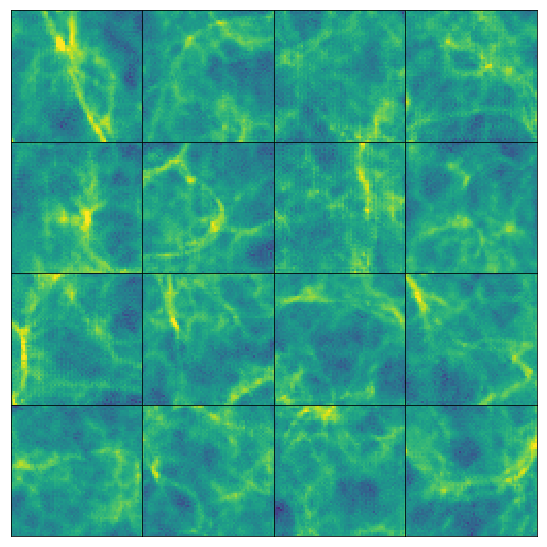

In [25]:
plot_grid(G=netG,  size = (4, 4), save='',  show_plot=True)

# Epoch 13, 0 extra layers tanh new trans, prince

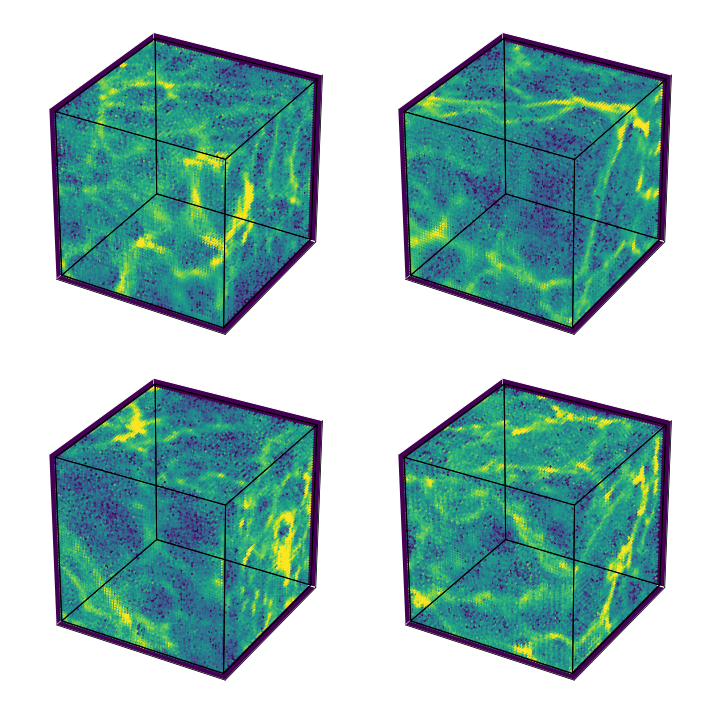

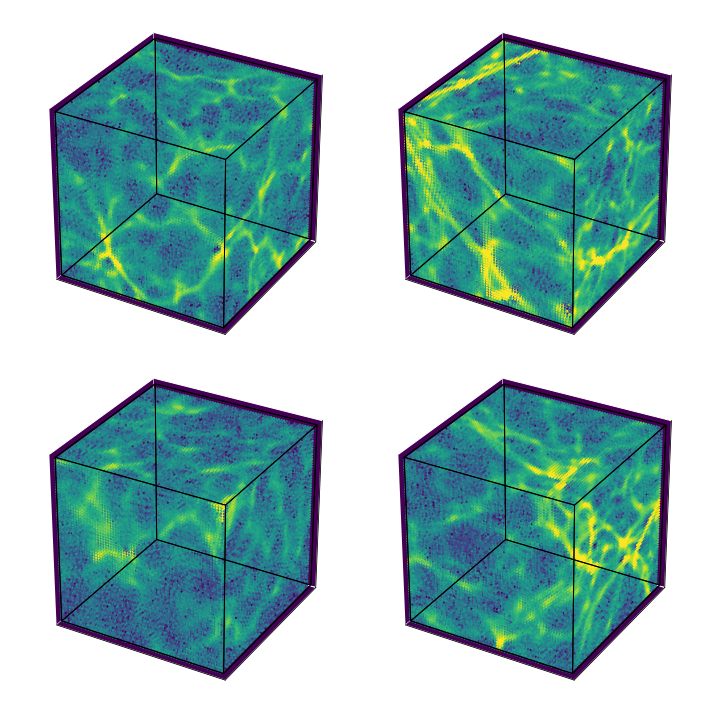

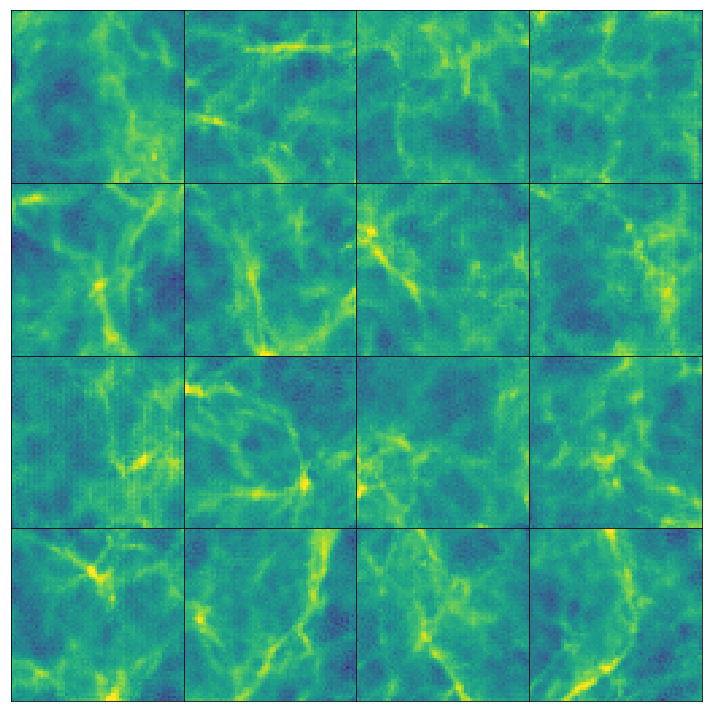

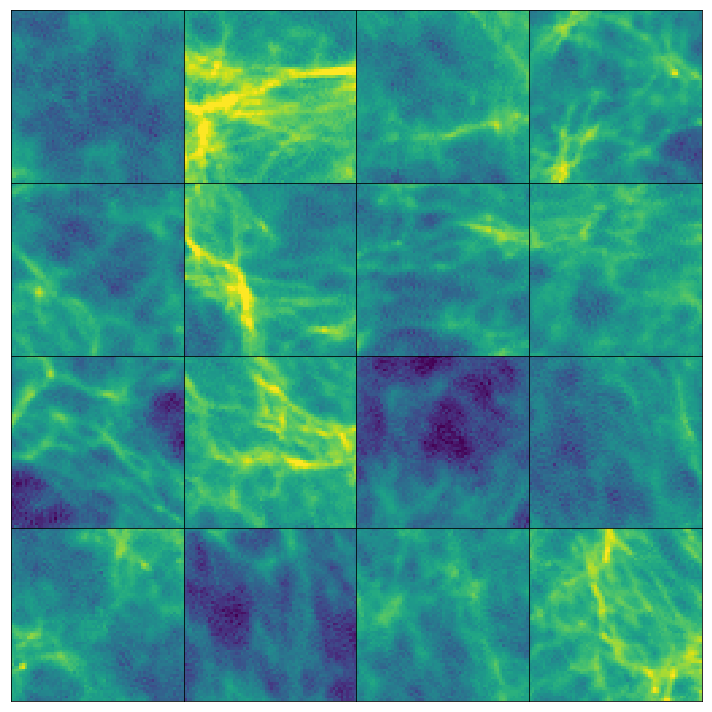

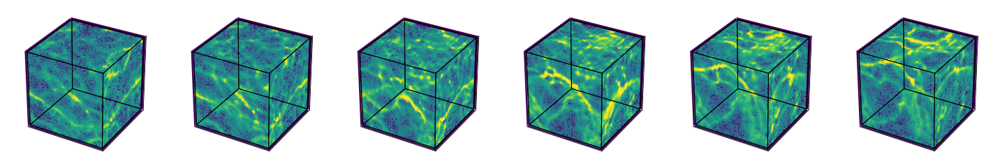

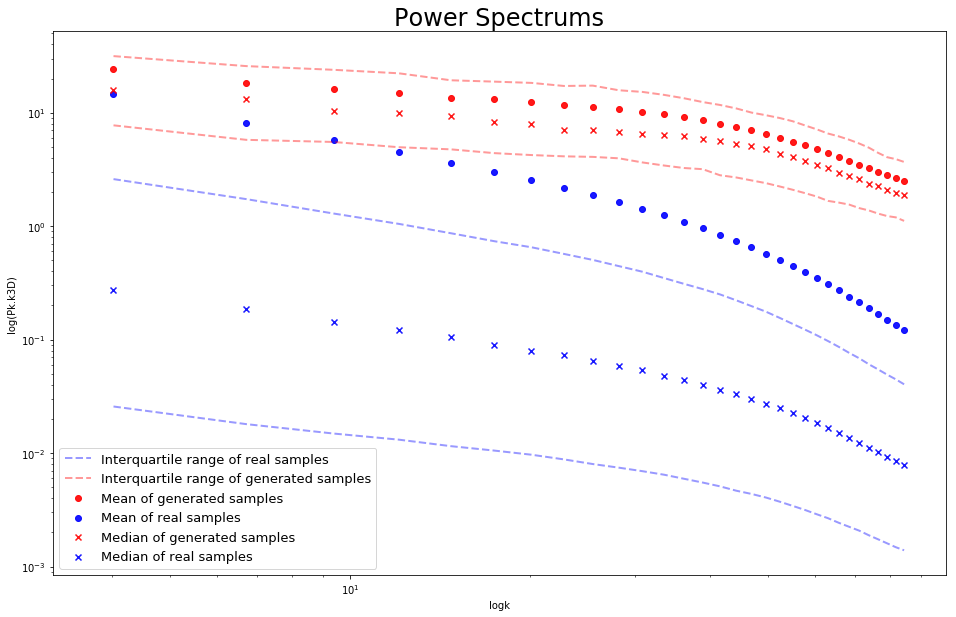

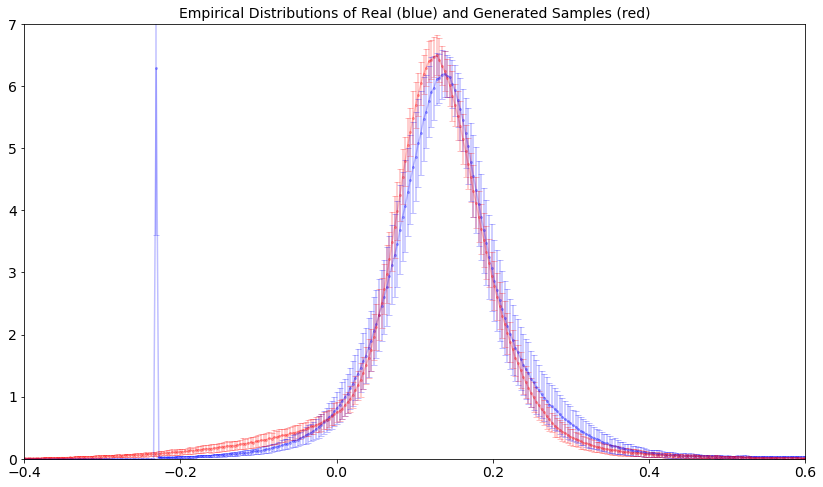

In [20]:
print('Generated')
plot_grid_3D(G=netG, size = (2,2), plot_show=True, save='', fig_size=(8,8))
print('Real')
plot_grid_3D(G=None, size = (2,2), plot_show=True, save='', fig_size=(8,8))

plot_grid(G=netG,  size = (4, 4), save='',  show_plot=True)
plot_grid(G=None,  size = (4, 4), save='',  show_plot=True)
#plot_grid(G=netG,  size = (5, 5), save='images_paper/3d/',  show_plot=True)

plot_interpolations(netG, num_vectors=6, mode='Linear', dim='3D', plot_show=True, save='', fig_size=(20,20))

real, fake = 0,0
plot_power_means_(mean_5, 500, netG, transform= True, log_scale=True, errors=False, iqr=True, adjust=False)

n = 16
dataloader = torch.utils.data.DataLoader(dataset, batch_size = n, shuffle=True, num_workers=0, drop_last = True)
data_iter = iter(dataloader)
real = data_iter.next().numpy()

noise = torch.FloatTensor(n, nz,1 , 1, 1).normal_(0, std_z)
fake = netG(Variable(noise)).detach().numpy()

histogram_mean_confint(fake, real, log_plot=False, t = 1, save_plot='', show_plot=True, adjust= False)

# Epoch 37, tanh lambda 1, prince

Real sample


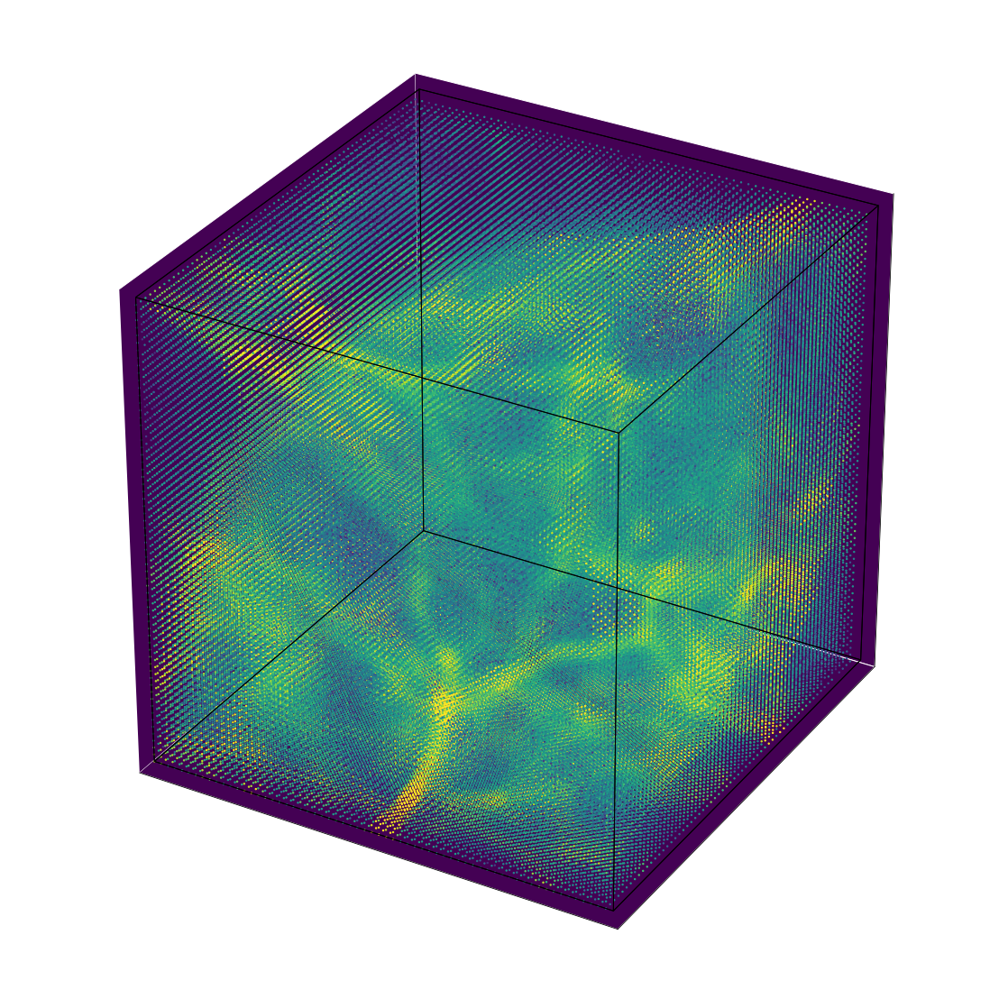

Generated sample


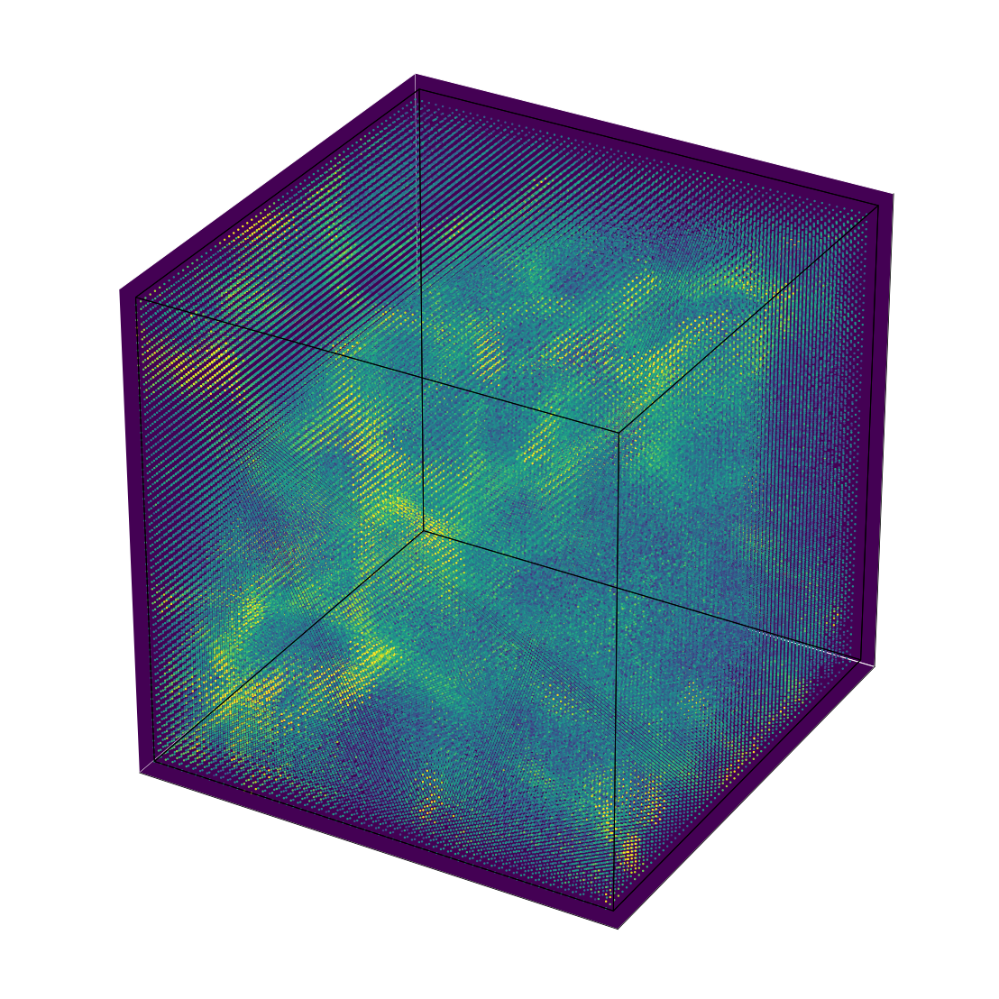

In [10]:
generate_3d_images(no_images=1, dataset=dataset, save_plot='')

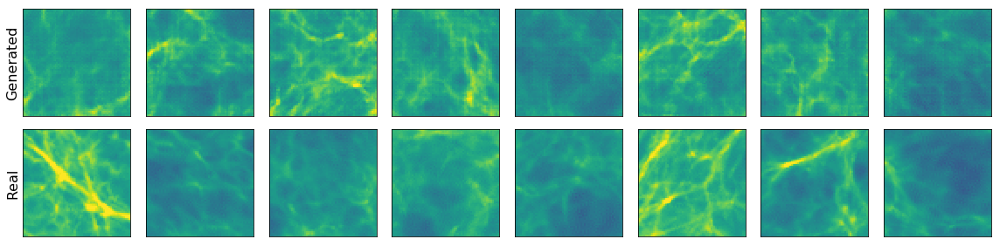

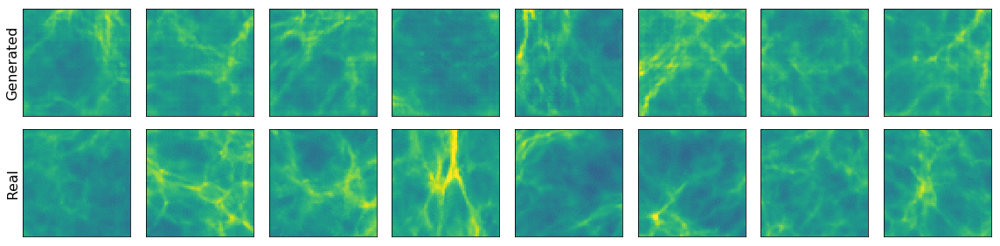

In [11]:
generate_images(netG, 2, '3', dataset, save_plot='')

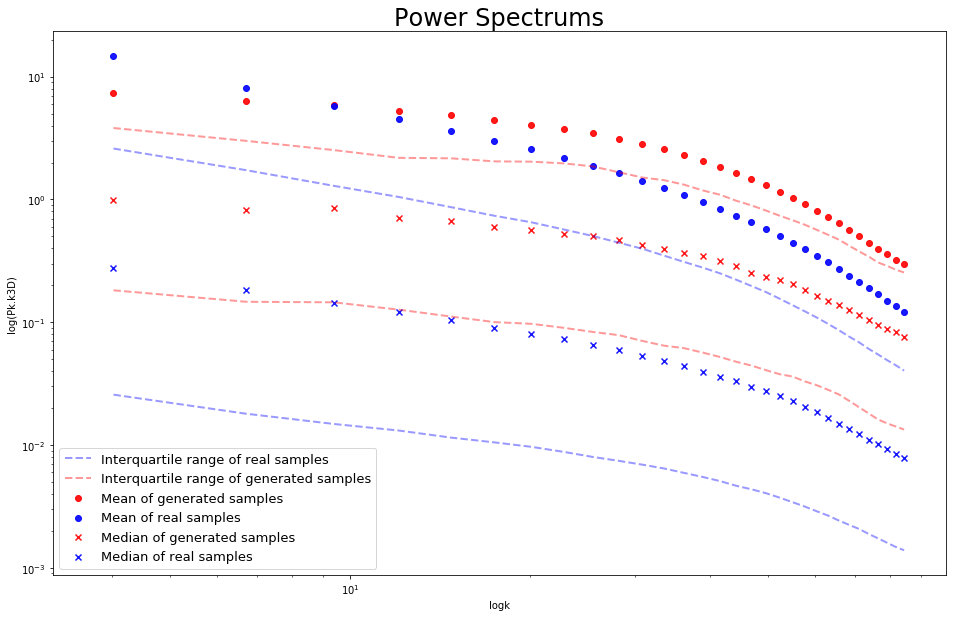

In [12]:
real, fake = 0,0
plot_power_means_(mean_5, 1000, netG, transform= True, log_scale=True, errors=False, iqr=True, adjust=False)

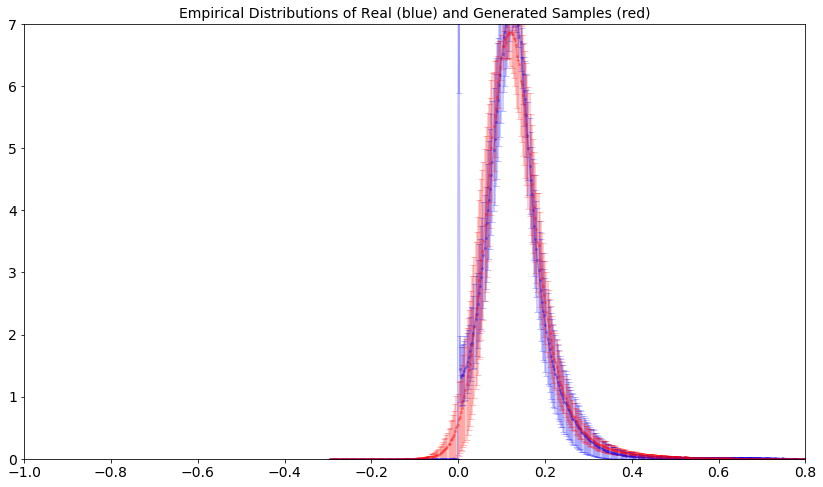

In [13]:
n = 8
dataloader = torch.utils.data.DataLoader(dataset, batch_size = n, shuffle=True, num_workers=0, drop_last = True)
data_iter = iter(dataloader)
real = data_iter.next().numpy()

noise = torch.FloatTensor(n, nz,1 , 1, 1).normal_(0, std_z)
fake = netG(Variable(noise)).detach().numpy()

histogram_mean_confint(fake, real, log_plot=False, t = 1, save_plot='', show_plot=True, adjust= False)

# Epoch 39, tanh 3 extra, prince

Real sample


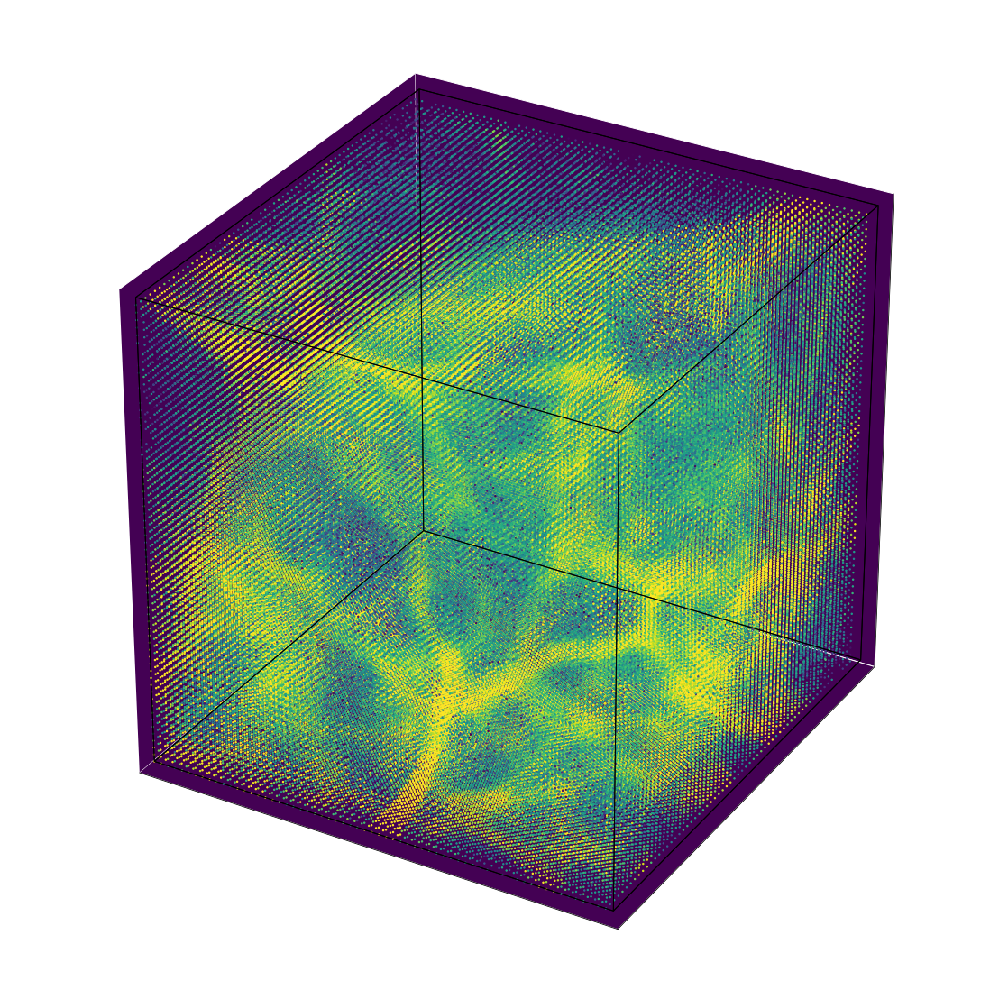

Generated sample


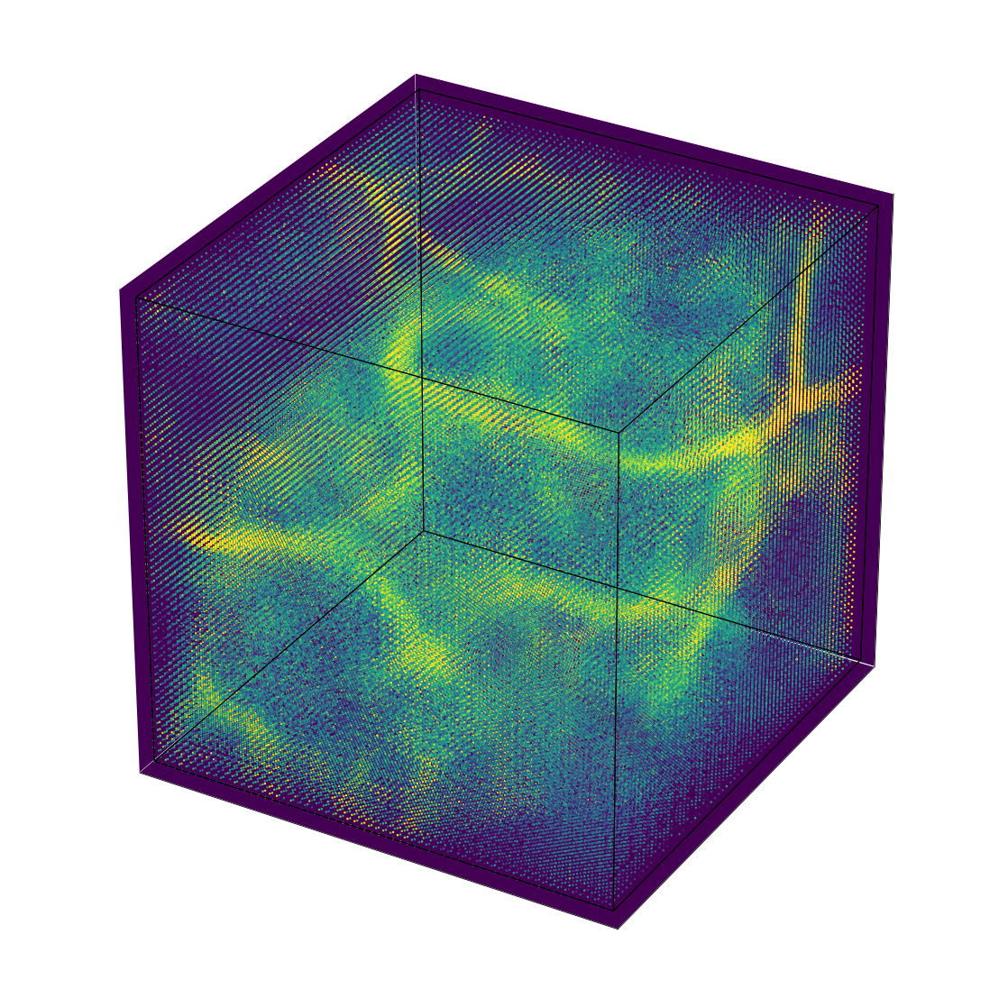

In [9]:
generate_3d_images(no_images=1, dataset=dataset, save_plot='')

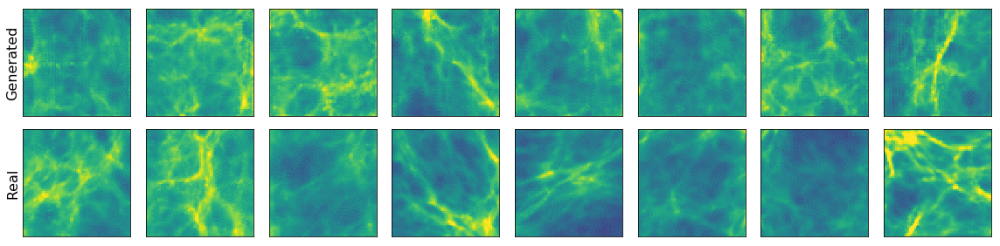

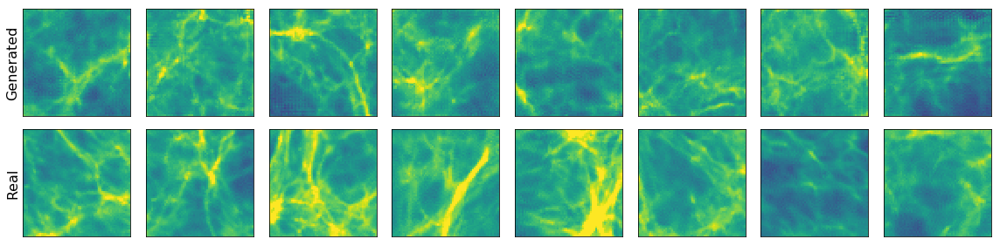

In [6]:
generate_images(netG, 2, '3', dataset, save_plot='')

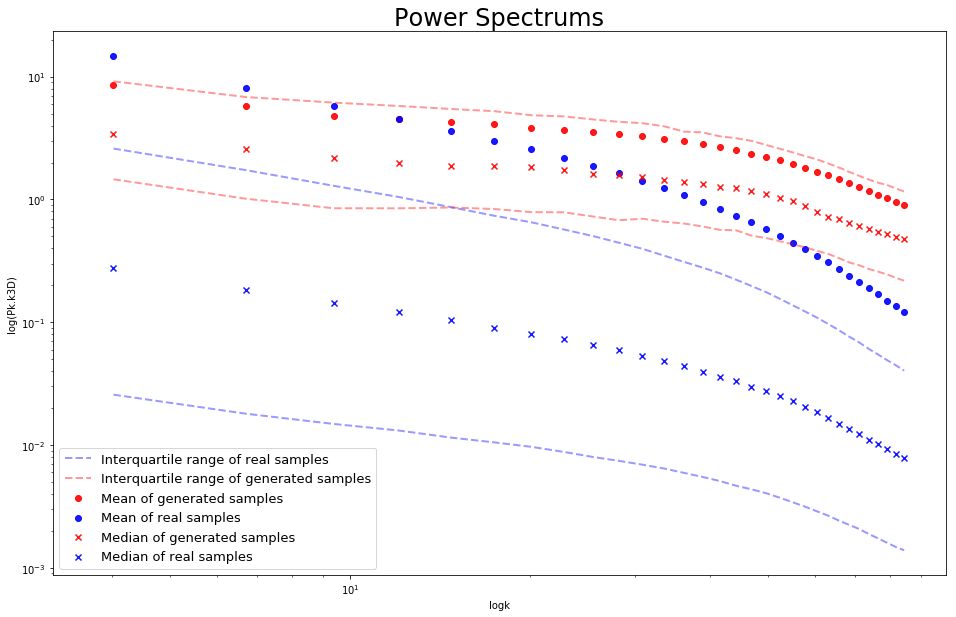

In [7]:
real, fake = 0,0
plot_power_means_(mean_5, 2000, netG, transform= True, log_scale=True, errors=False, iqr=True, adjust=False)

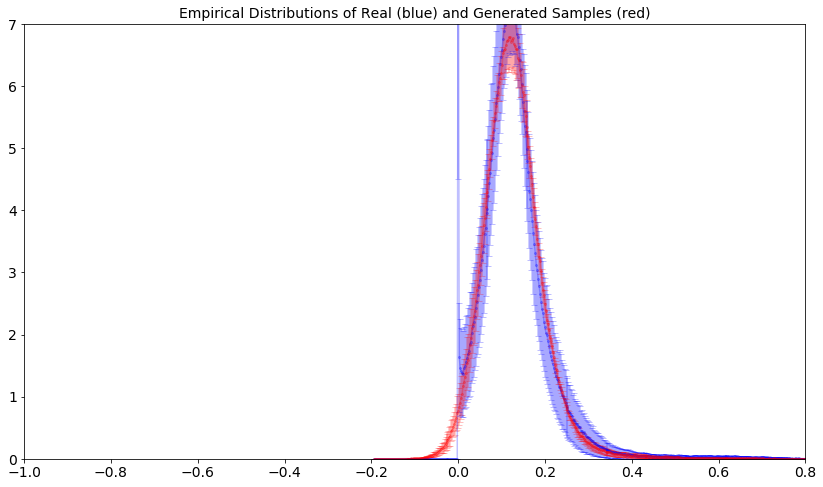

In [8]:
n = 8
dataloader = torch.utils.data.DataLoader(dataset, batch_size = n, shuffle=True, num_workers=0, drop_last = True)
data_iter = iter(dataloader)
real = data_iter.next().numpy()

noise = torch.FloatTensor(n, nz,1 , 1, 1).normal_(0, std_z)
fake = netG(Variable(noise)).detach().numpy()

histogram_mean_confint(fake, real, log_plot=False, t = 1, save_plot='', show_plot=True, adjust= False)

# Epoch 92, tanh (prince)

Real sample


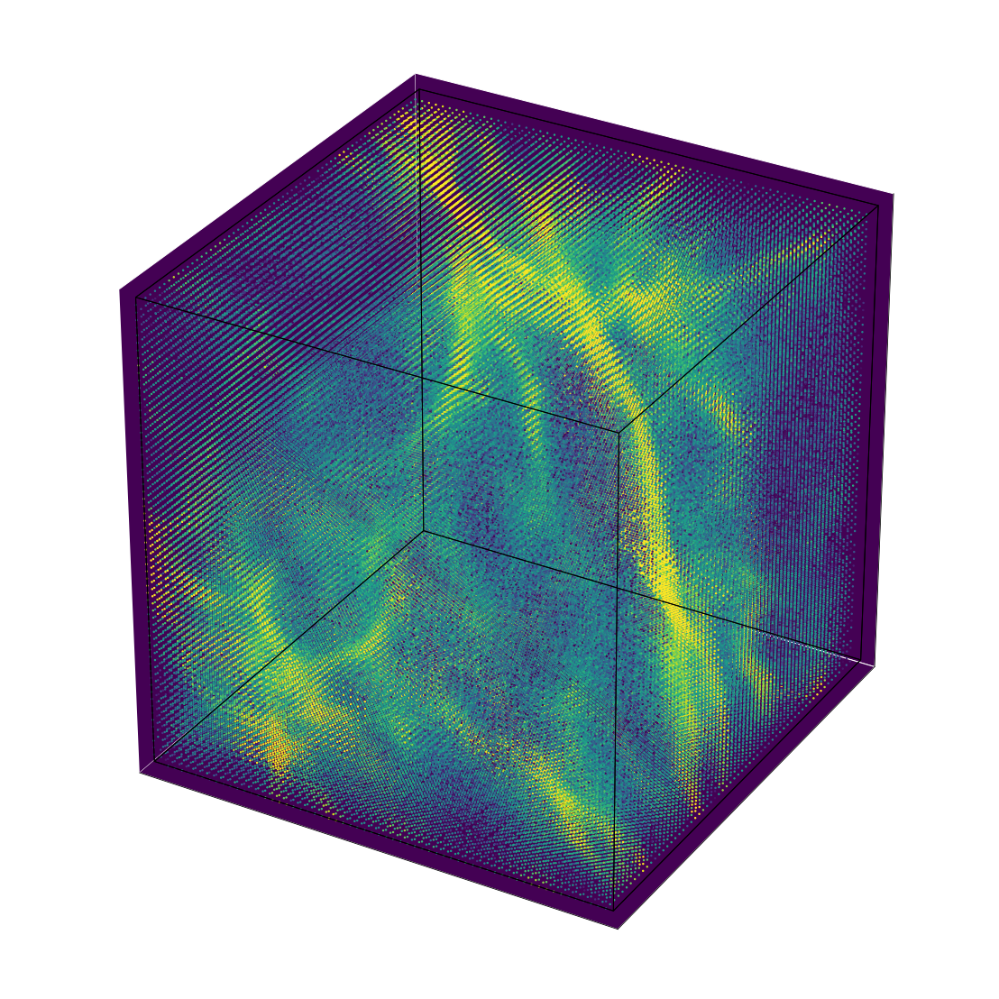

Generated sample


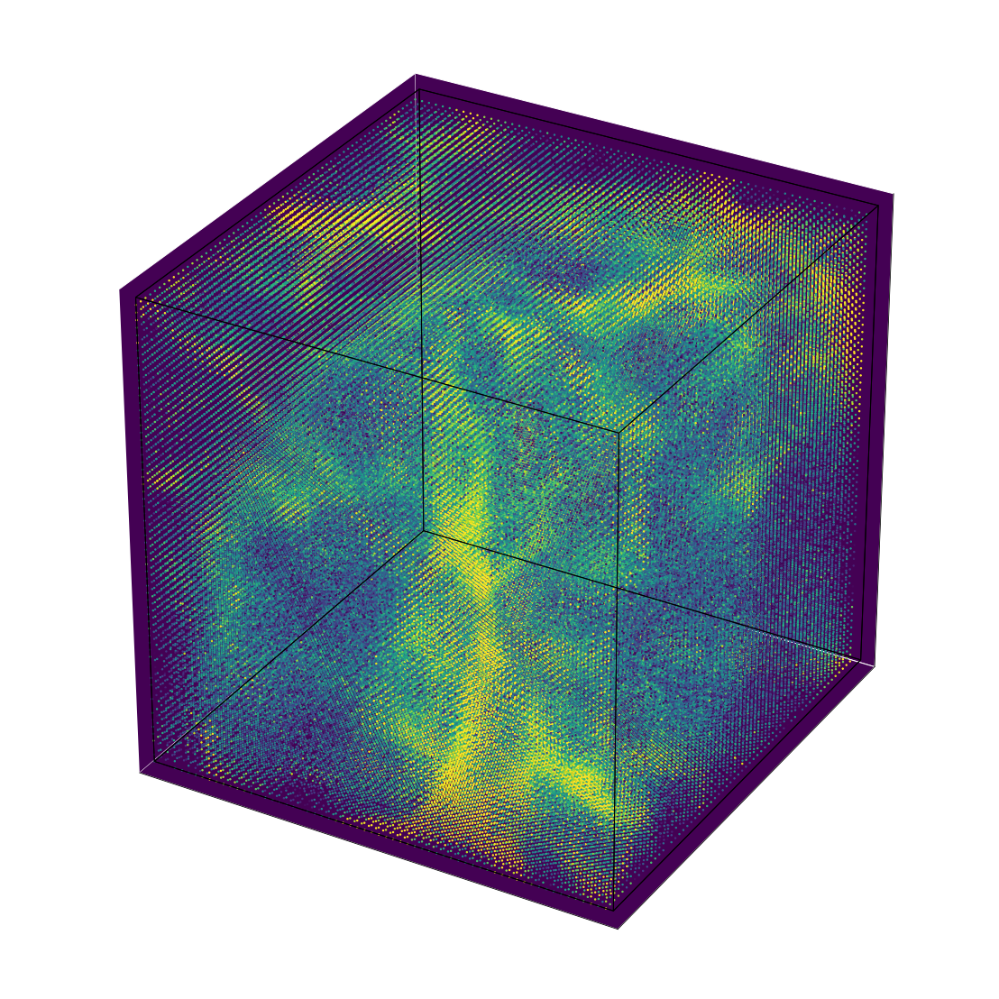

In [12]:
generate_3d_images(no_images=1, dataset=dataset, save_plot='')

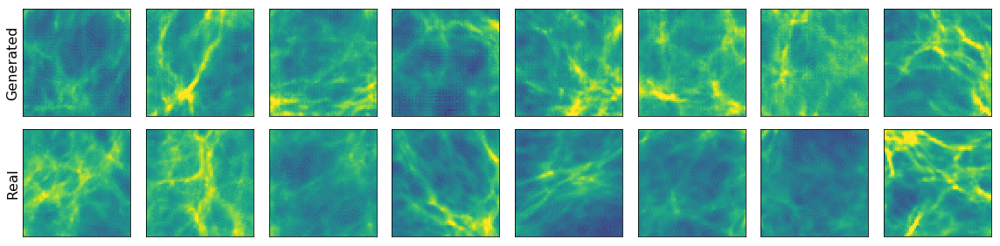

In [6]:
generate_images(netG, 1, '3', dataset, save_plot='')

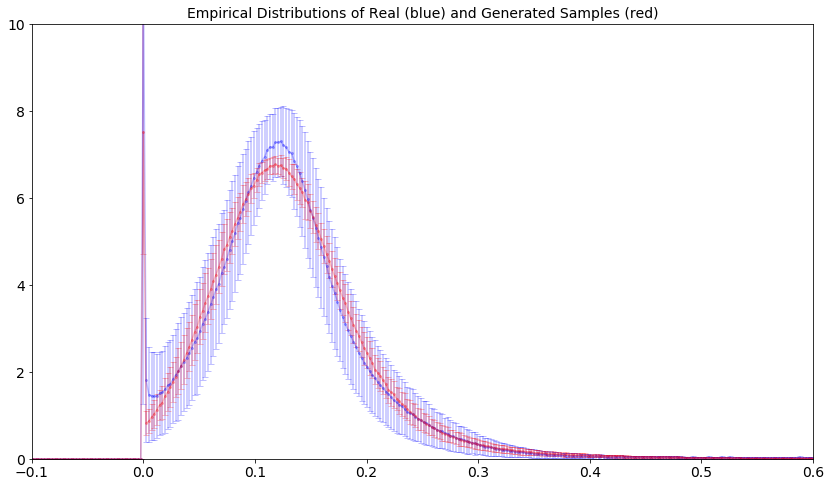

In [11]:
n = 16
dataloader = torch.utils.data.DataLoader(dataset, batch_size = n, shuffle=True, num_workers=0, drop_last = True)
data_iter = iter(dataloader)
real = data_iter.next().numpy()

noise = torch.FloatTensor(n, nz,1 , 1, 1).normal_(0, std_z)
fake = netG(Variable(noise)).detach().numpy()

histogram_mean_confint(fake, real, log_plot=False, t = 1, save_plot='', show_plot=True, adjust= True)

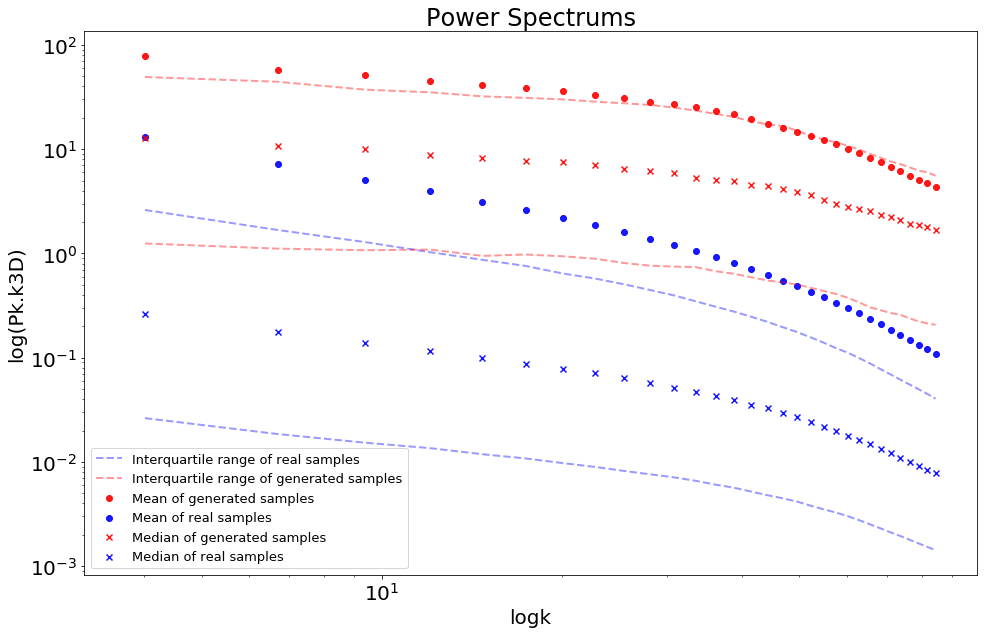

In [9]:
plot_power_means_(mean_5, 5000, netG, transform= True, log_scale=True, errors=False, iqr=True)

# Epoch 35, tanh (prince)

Real sample


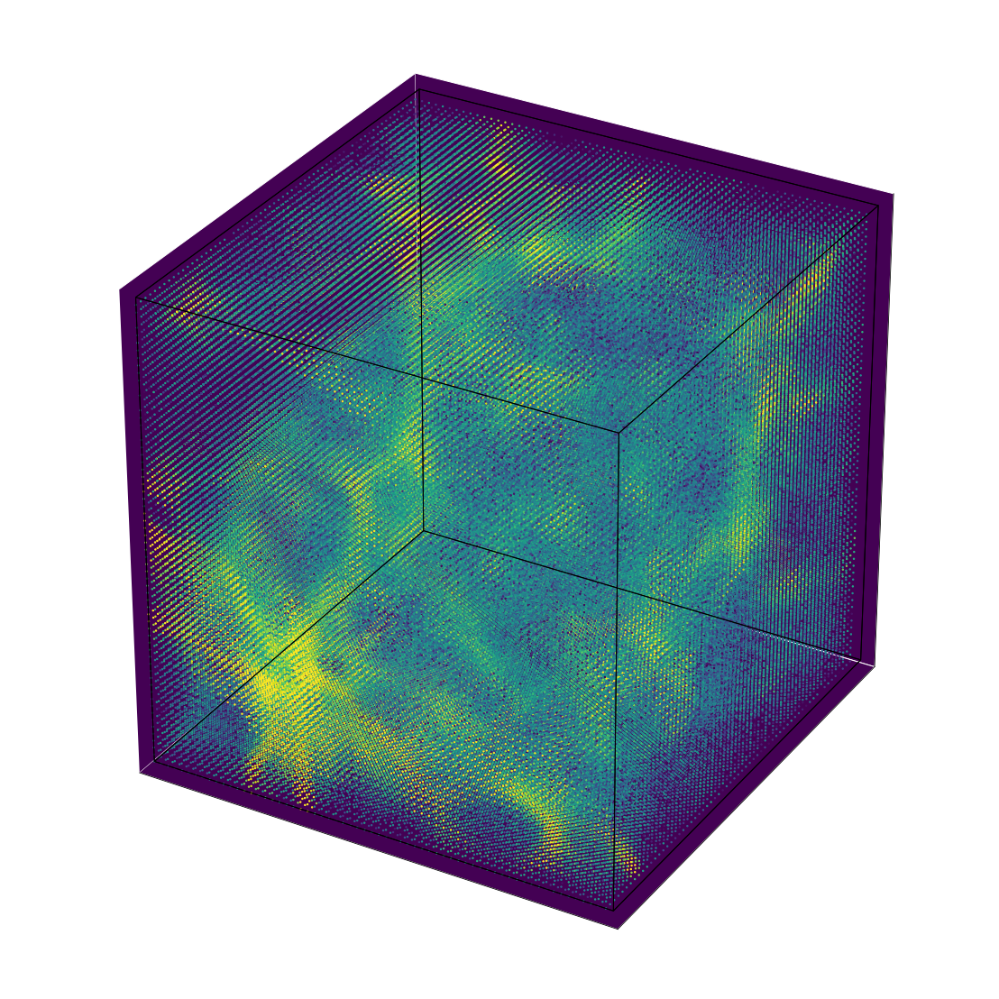

Generated sample


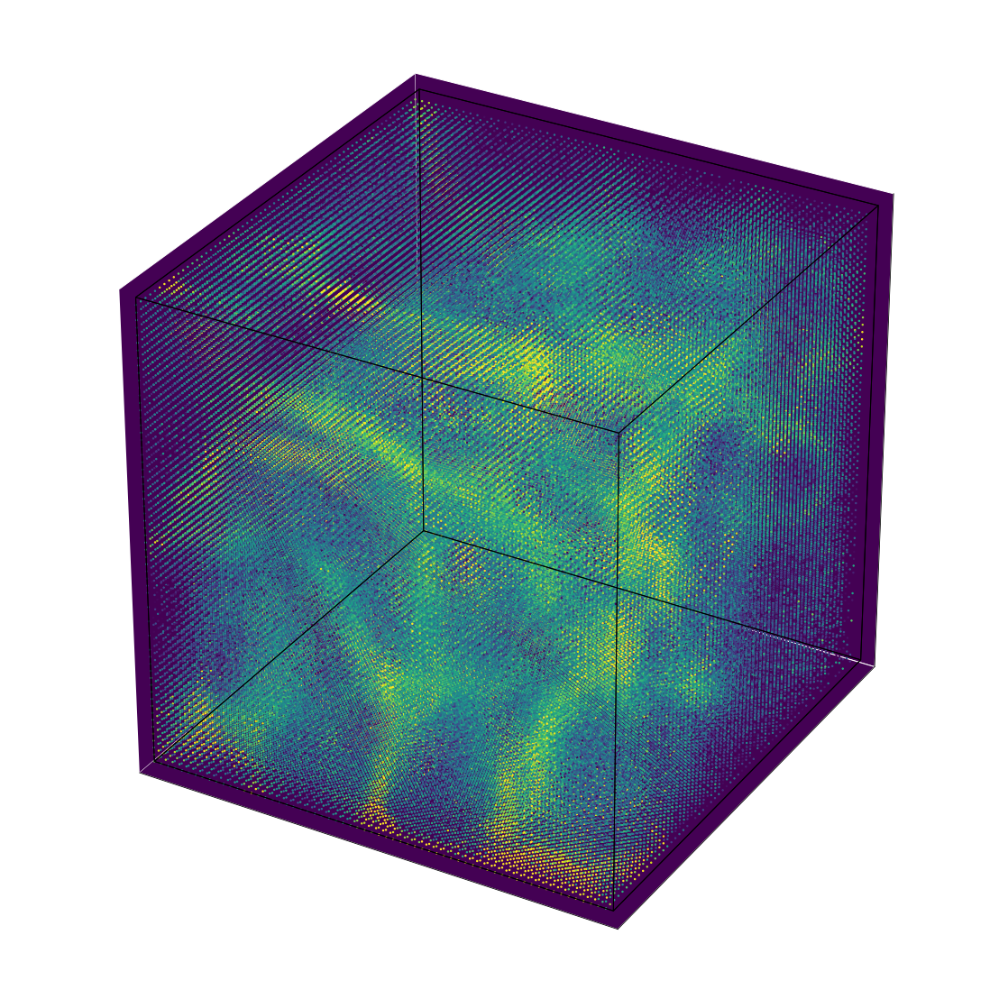

In [66]:
generate_3d_images(no_images=1, dataset=dataset, save_plot='')

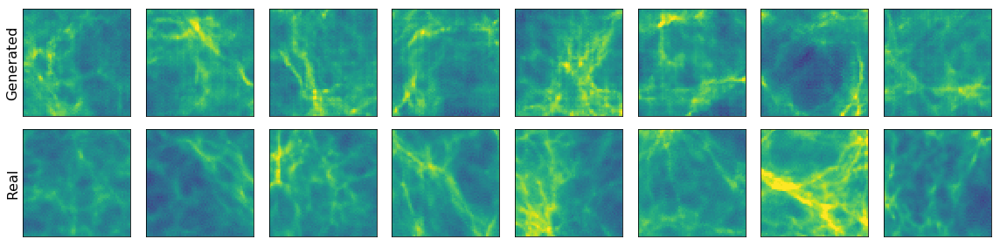

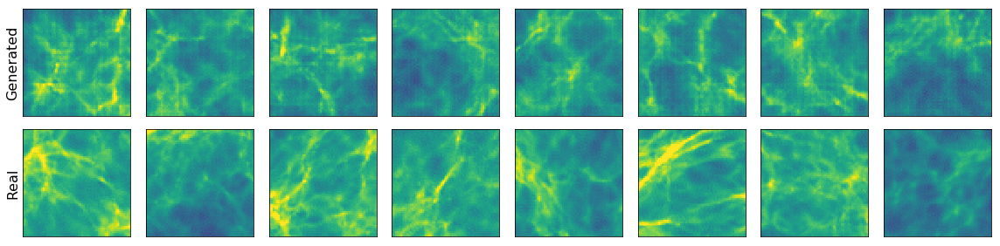

In [67]:
generate_images(netG, 2, '3', dataset, save_plot='')

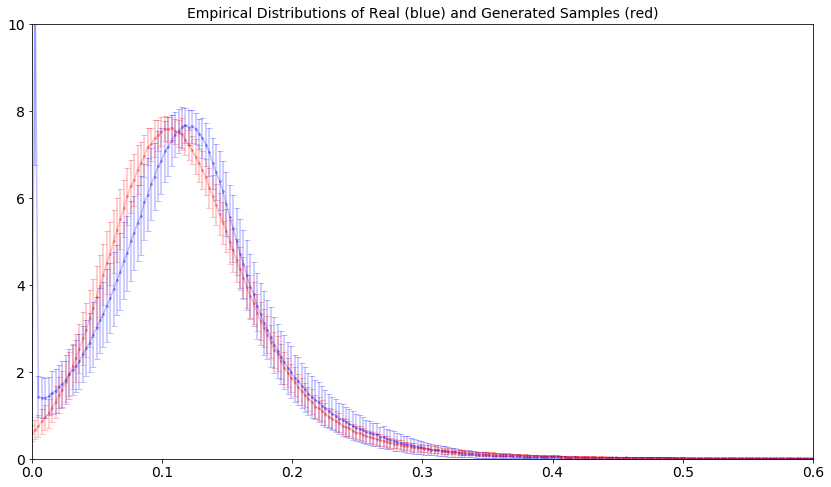

In [68]:
n = 100
dataloader = torch.utils.data.DataLoader(dataset, batch_size = n, shuffle=True, num_workers=0, drop_last = True)
data_iter = iter(dataloader)
real = data_iter.next().numpy()

noise = torch.FloatTensor(n, nz,1 , 1, 1).normal_(0, std_z)
fake = netG(Variable(noise)).detach().numpy()

histogram_mean_confint(fake, real, log_plot=False, t = 1, save_plot='', show_plot=True)

In [10]:
plot_power_means_(mean_5, 1000, netG, log_scale=True, errors=False, iqr=True)

TypeError: plot_power_means_() missing 1 required positional argument: 'transform'

# Epoch 19, tanh (local)

Real sample


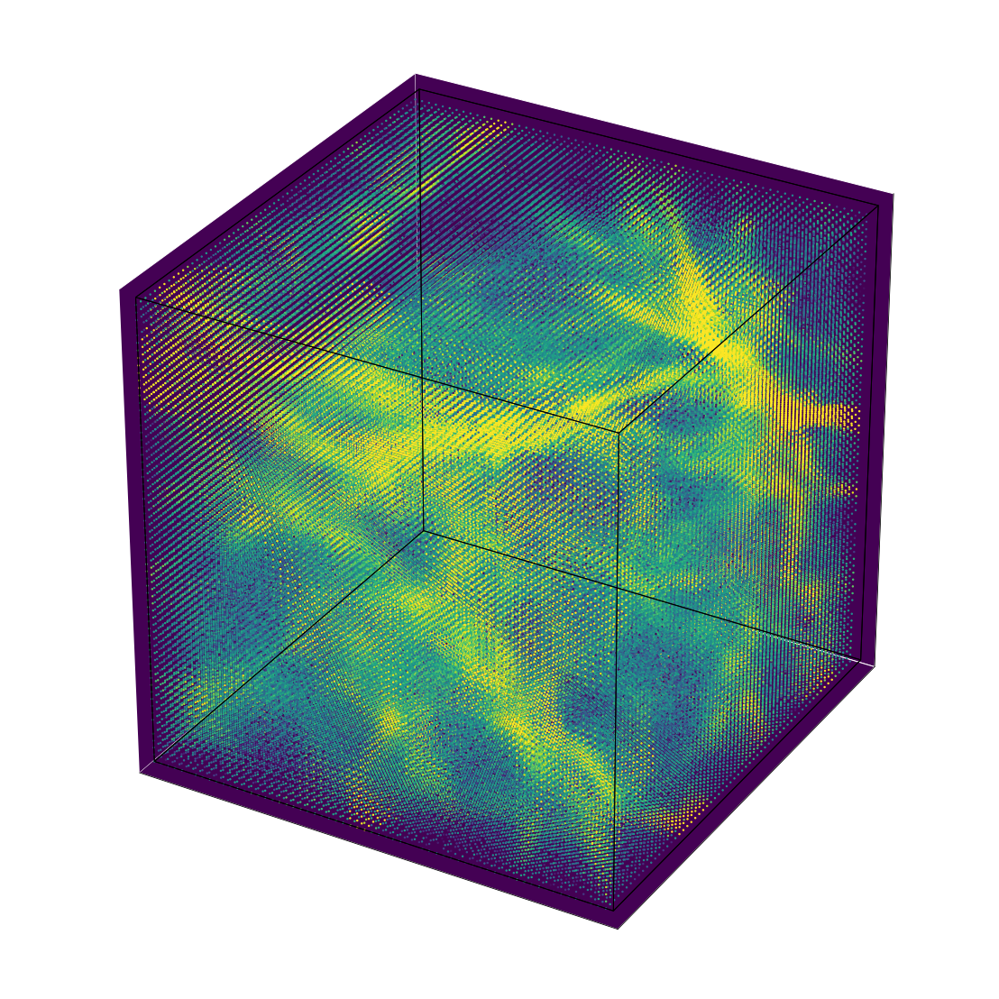

Generated sample


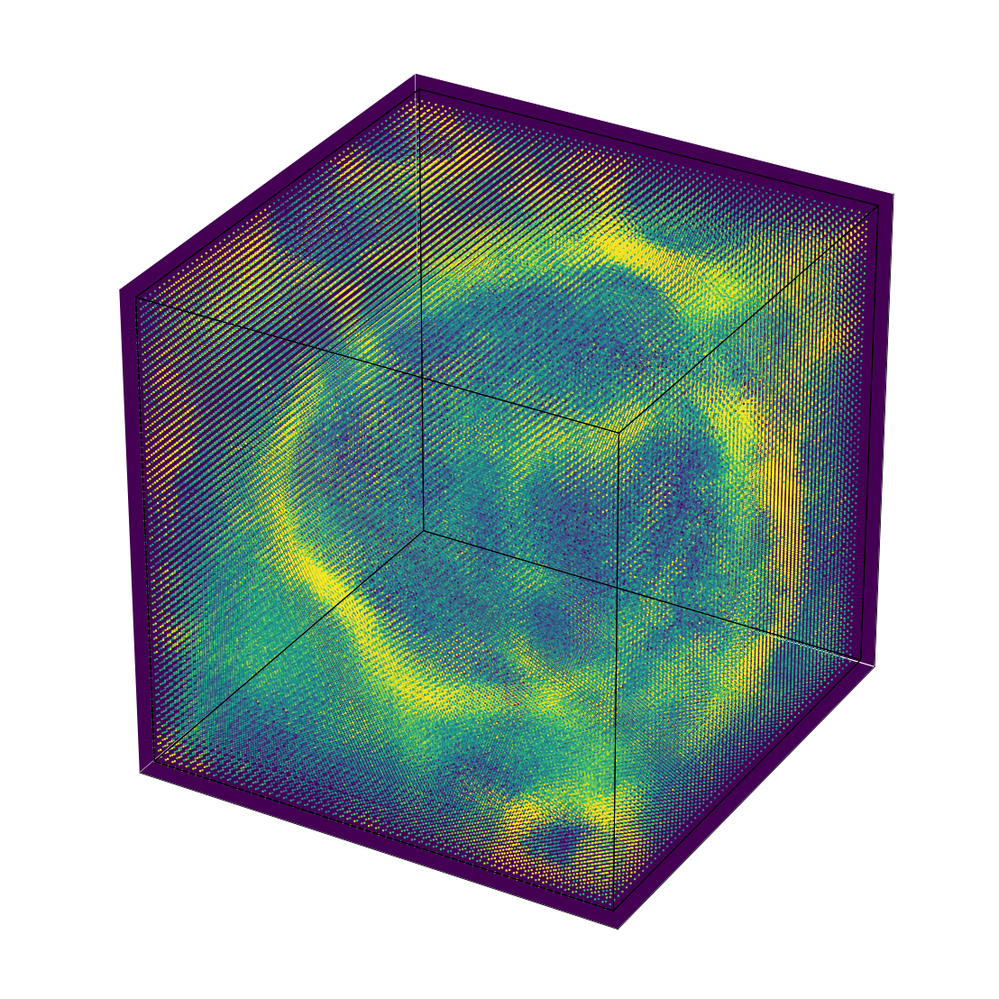

In [20]:
generate_3d_images(no_images=1, dataset=dataset, save_plot='')

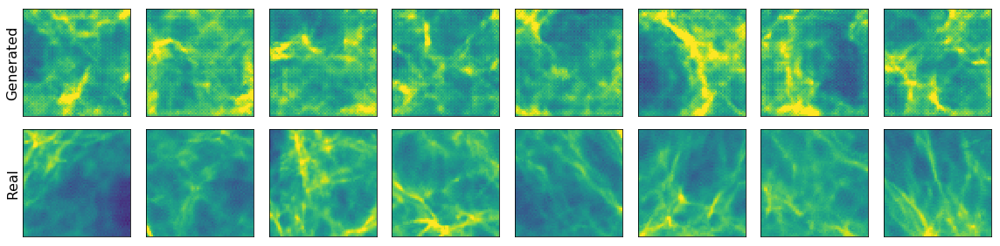

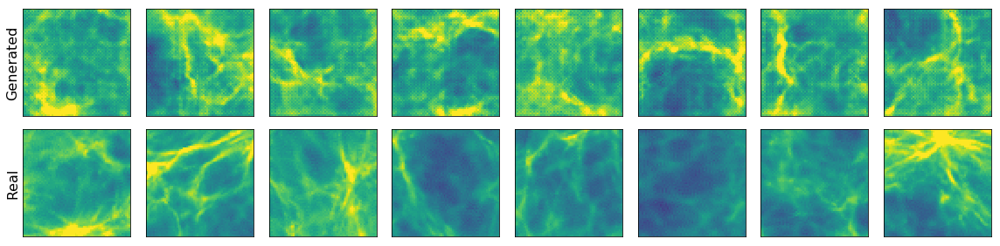

In [21]:
generate_images(netG, 2, '3', dataset, save_plot='')

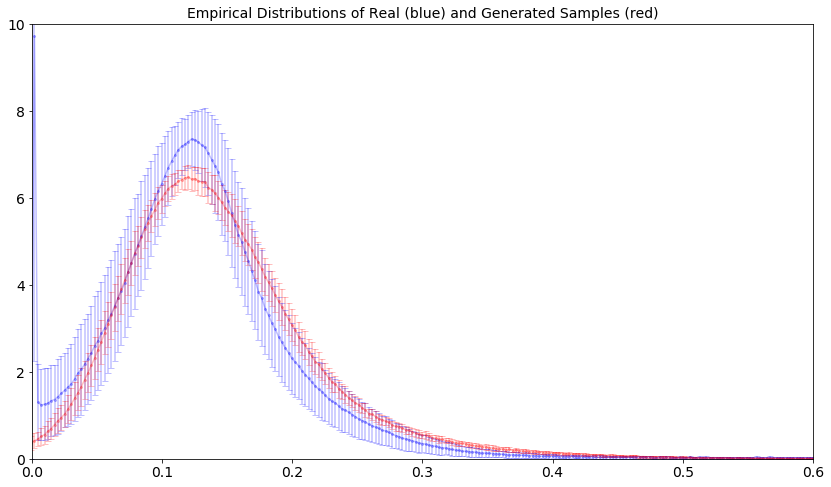

In [22]:
n = 80
dataloader = torch.utils.data.DataLoader(dataset, batch_size = n, shuffle=True, num_workers=0, drop_last = True)
data_iter = iter(dataloader)
real = data_iter.next().numpy()

noise = torch.FloatTensor(n, nz,1 , 1, 1).normal_(0, std_z)
fake = netG(Variable(noise)).detach().numpy()

histogram_mean_confint(fake, real, log_plot=False, t = 1, save_plot='', show_plot=True)

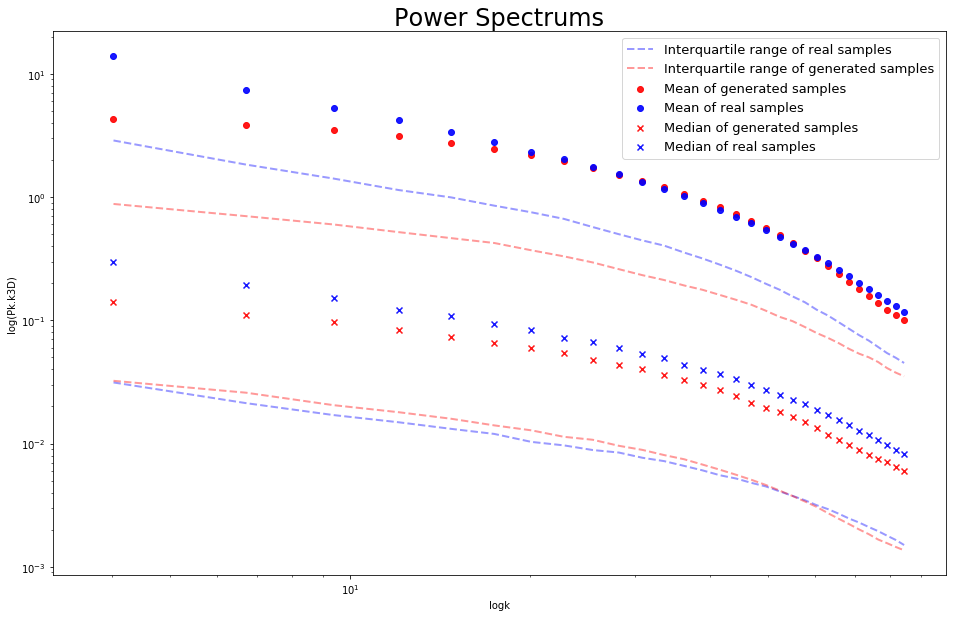

In [23]:
plot_power_means_(mean_5, 1000, netG, log_scale=True, errors=False, iqr=True)

# Epoch 39

Real sample


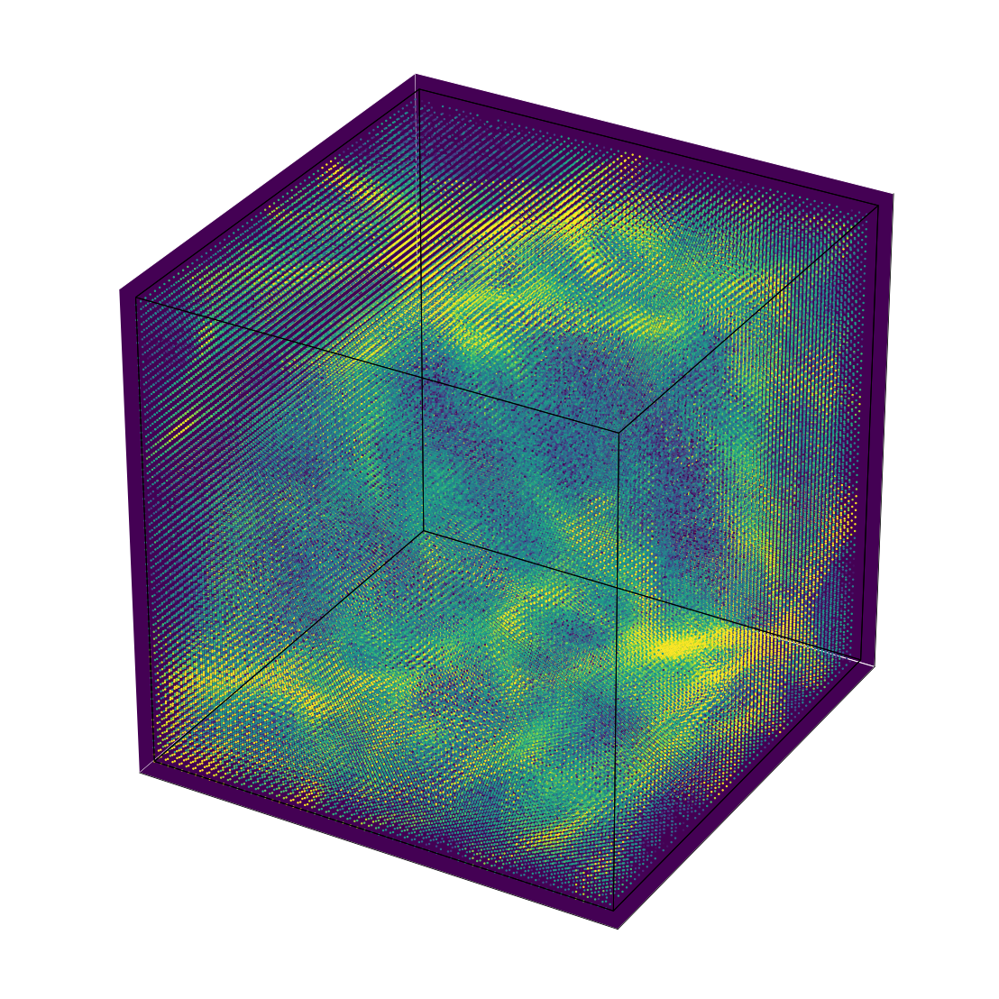

Generated sample


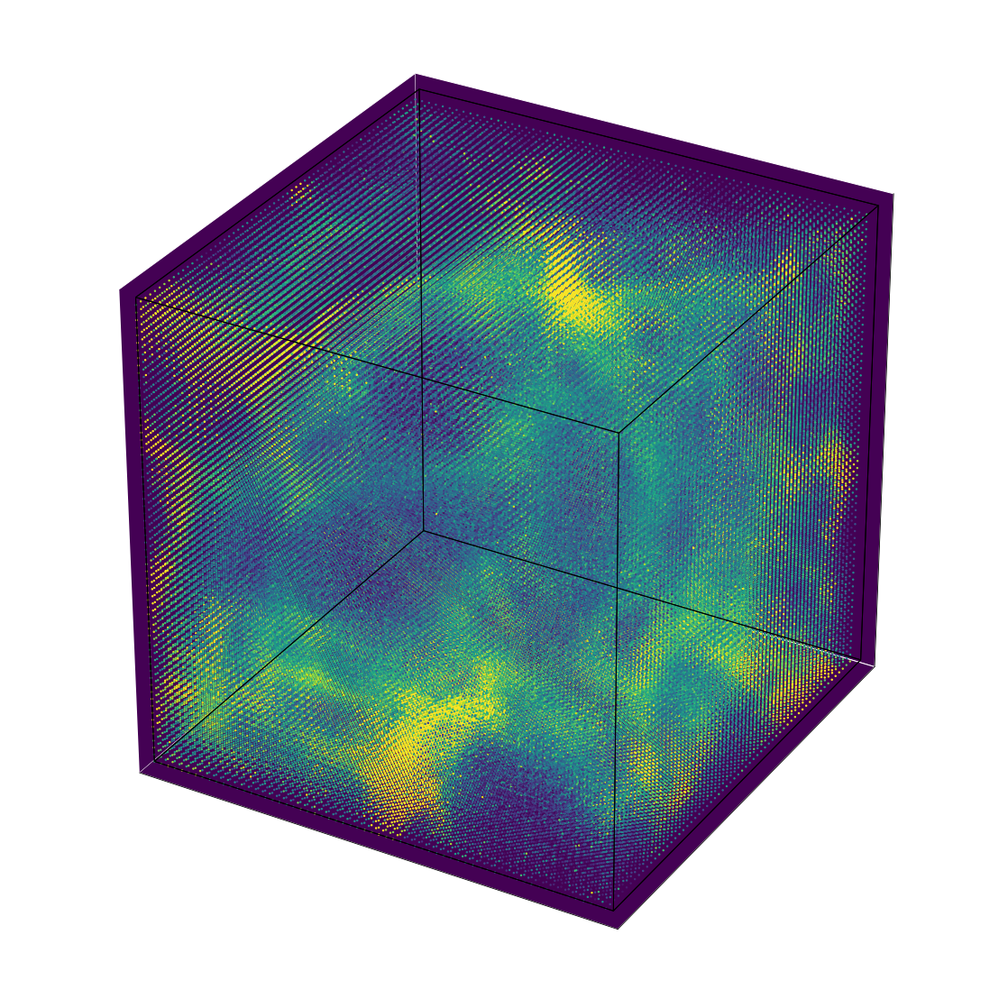

In [6]:
generate_3d_images(no_images=1, dataset=dataset, save_plot='')

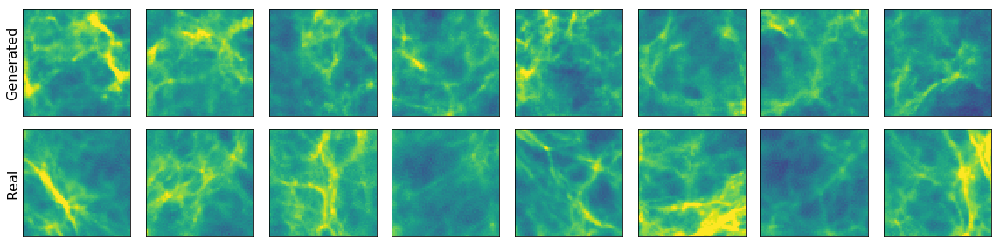

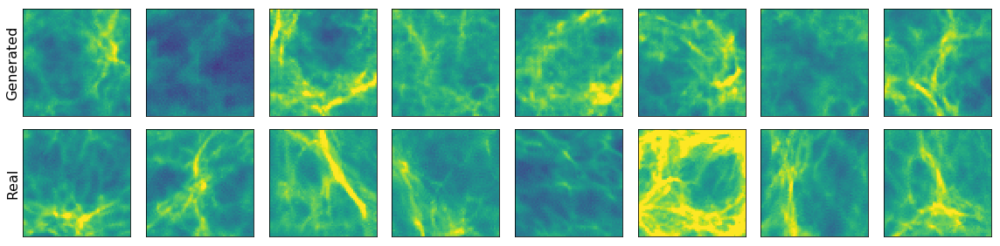

In [7]:
generate_images(netG, 2, '3', dataset, save_plot='')

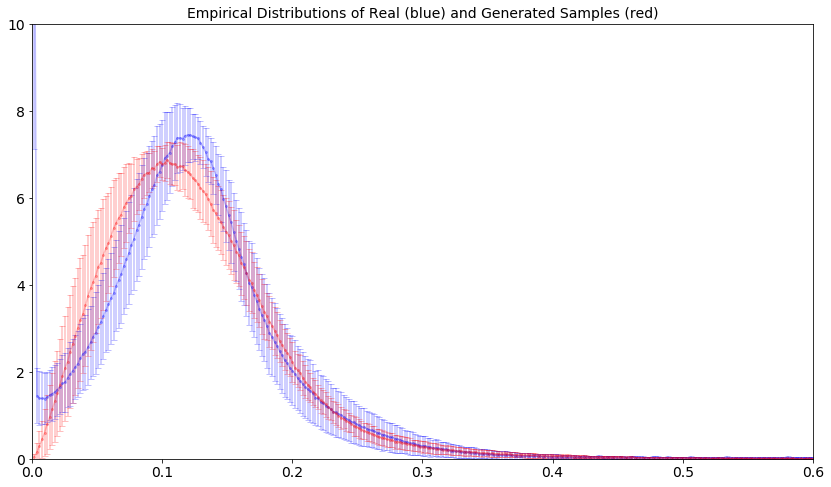

In [11]:
n = 128
dataloader = torch.utils.data.DataLoader(dataset, batch_size = n,shuffle=False, num_workers=0, drop_last = True)
data_iter = iter(dataloader)
real = data_iter.next().numpy()

noise = torch.FloatTensor(n, nz,1 , 1, 1).normal_(0, std_z)
fake = netG(Variable(noise)).detach().numpy()

histogram_mean_confint(fake, real, log_plot=False, t = 1, save_plot='', show_plot=True)

1000 / 2000


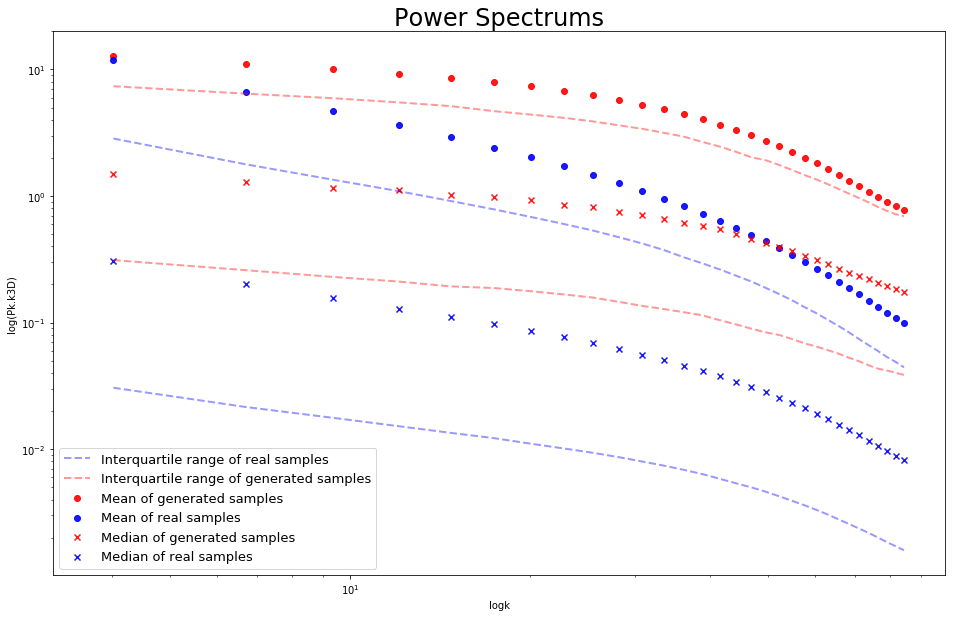

In [10]:
plot_power_means_(mean_5, 2000, netG, log_scale=True, errors=False, iqr=True)

# Epoch 31

In [ ]:
generate_3d_images(no_images=1, dataset=dataset, save_plot='')

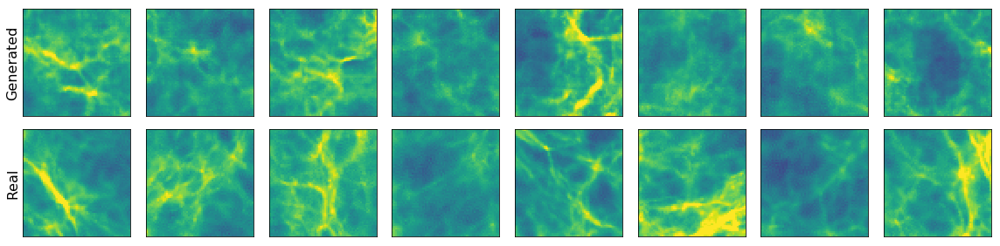

In [7]:
generate_images(netG, 2, '3', dataset, save_plot='')

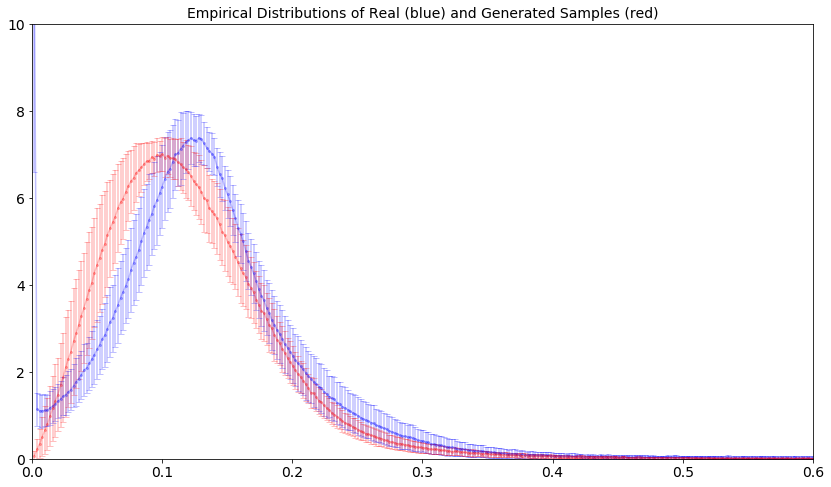

In [8]:
n = 128
dataloader = torch.utils.data.DataLoader(dataset, batch_size = n,shuffle=False, num_workers=0, drop_last = True)
data_iter = iter(dataloader)
real = data_iter.next().numpy()

noise = torch.FloatTensor(n, nz,1 , 1, 1).normal_(0, std_z)
fake = netG(Variable(noise)).detach().numpy()

histogram_mean_confint(fake, real, log_plot=False, t = 1, save_plot='', show_plot=True)

1000 / 3000
2000 / 3000


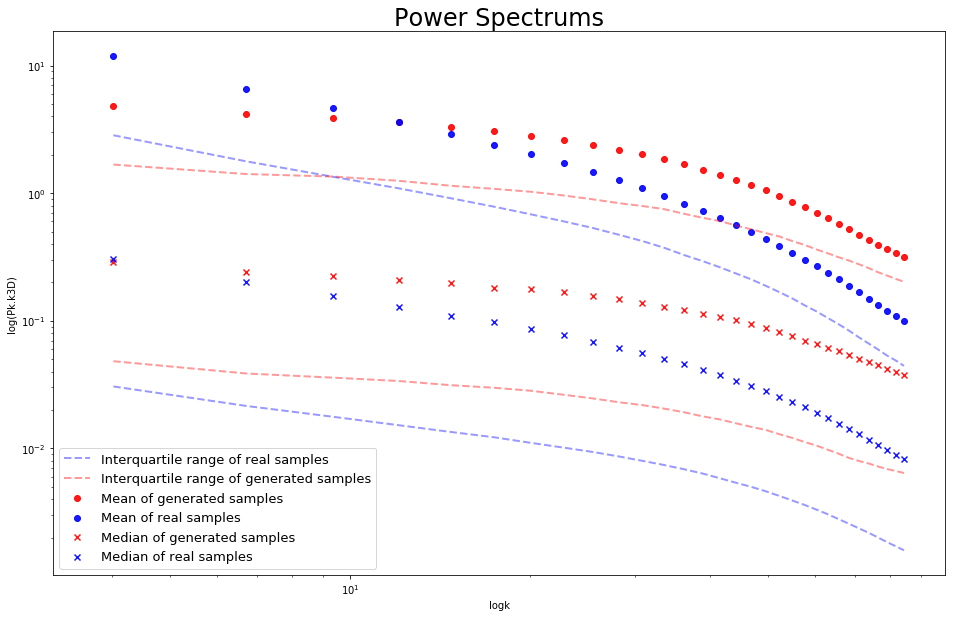

In [9]:
plot_power_means_(mean_5, 3000, netG, log_scale=True, errors=False, iqr=True)

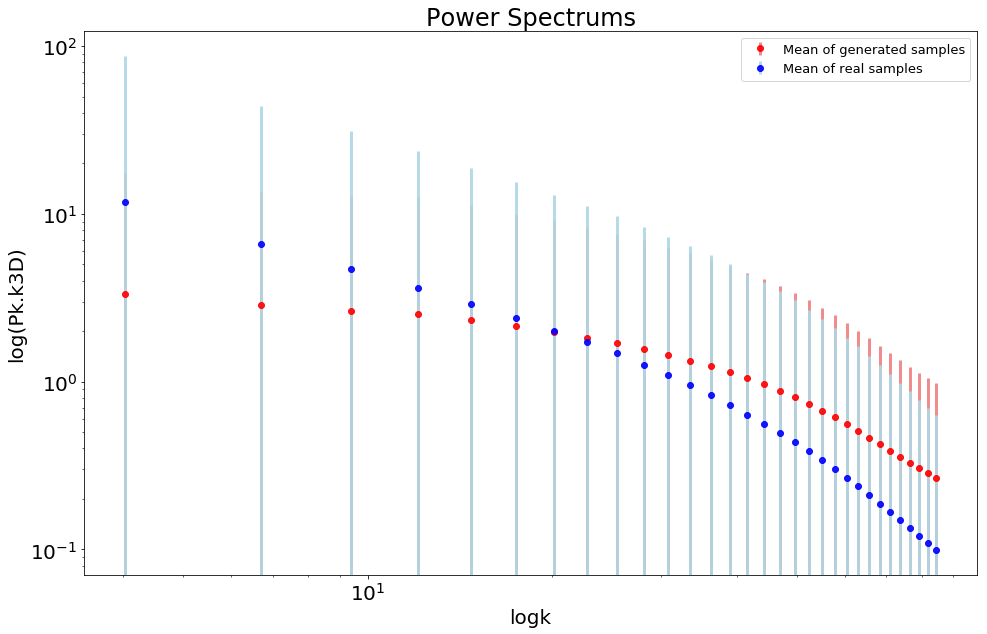

In [10]:
plot_power_means_(mean_5, 1000, netG, log_scale=True, errors=True, iqr=False)

## To save samples

In [22]:
batch_s=100
noise = torch.FloatTensor(batch_s, 100, 1 , 1, 1).normal_(0, std_z)
fake = netG(Variable(noise)).detach().numpy()
#fake = fake 
fake= (np.exp(fake * max_l5) -1)
fake.shape
torch.save(fake, '3d_epoch_77.pickle', pickle_protocol=1)

(100, 1, 64, 64, 64)

In [9]:
myfile = open('samples_WGAN.pickle', 'wb')
pickle.dump(fake, myfile, protocol=2)
myfile.close()

In [ ]:
batch_s = 128
noise = torch.FloatTensor(batch_s, 100, 1 , 1, 1).normal_(0, std_z)
fake = netG(Variable(noise)).detach().numpy()
fake = (np.exp(fake * max_l5) -1)
torch.save(fake, '3d_epoch_19.pickle', pickle_protocol=1)

In [26]:
noise = torch.FloatTensor(1, 100, 1 , 1, 1).normal_(0, std_z)
fake = netG(Variable(noise)).detach().numpy()
fake.shape
fake[0][0].shape

(64, 64, 64)

In [30]:
ntot = 2000
sample_dir = 'prince_samples/3_extra/out-gen/'

for i in range(ntot):
    if i % 1000 == 0 and i>0:
        print(i)
    
    noise = torch.FloatTensor(1, 100, 1 , 1, 1).normal_(0, std_z)
    fake = netG(Variable(noise)).detach().numpy()
    fake = fake[0][0]
    
    fake = np.exp(fake * max_l5) -1
    
    torch.save(obj = fake, f = sample_dir + "sample_" + str(i) + ".pickle")

1000


In [ ]:
def save_samples(G, folder, nsamples, transform = True):
    
    for i in range(nsamples):
        if i % 1000 == 0 and i>0:
            print(i)
    
        noise = torch.FloatTensor(1, 100, 1 , 1, 1).normal_(0, std_z)
        fake = G(Variable(noise)).detach().numpy()
        fake = fake[0][0]

        if transform == True:
            fake = np.exp(fake * max_l5) -1

        torch.save(obj = fake, f = folder + "sample_" + str(i) + ".pickle")
        
    return

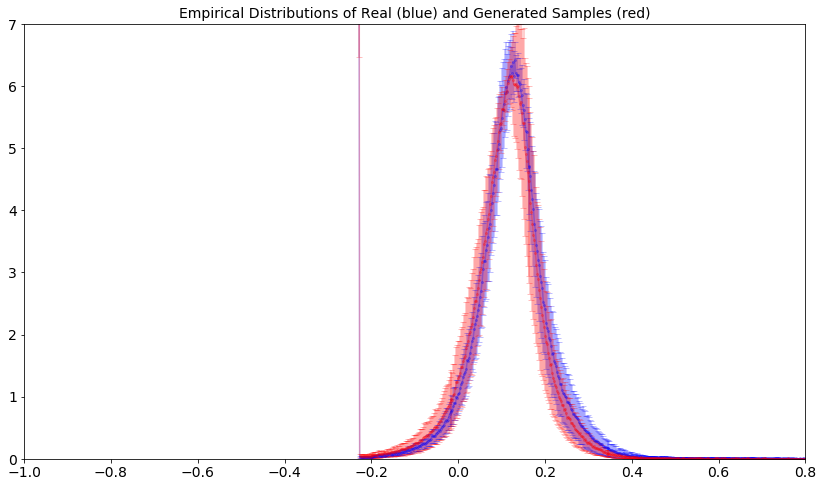

In [86]:
dataset = HydrogenDataset(part = partition, datapath='real_samples/', s_sample = s_sample, transform='None',d2=False)
dataloader = torch.utils.data.DataLoader(dataset, batch_size = 4, shuffle=True, num_workers=0, drop_last = True)
data_iter = iter(dataloader)

e = 1e-2
em = 1
real = data_iter.next().numpy()
real = np.log10(real + e) / (np.log10(max_5) - em)


real2 = data_iter.next().numpy()
real2 = np.log10(real2 + e) / (np.log10(max_5) - em)

histogram_mean_confint(real, real2, log_plot=False, t = 1, save_plot='', show_plot=True, adjust= False)

In [13]:
def data_transform(sample, transform, inverse=False):
    e = 1e-8
    em =1
    
    if transform == 'log_max':
        if inverse == False:
            sample = np.log10(sample + e) / (np.log10(max_5) - em)
        else:
            sample =10**(sample * (np.log10(max_5) - em)) - e
            
    if transform == 'log_max_p':
        if inverse == False:
            sample = np.log(sample +1) / (max_l5)
        else:
            sample =np.exp(sample * max_l5) - 1
        
    
    return sample

In [14]:
a= 1000000000000
b = data_transform(a, 'log_max', inverse=False)
c = data_transform(b, 'log_max', inverse=True)
a,b,c

(1000000000000, 1.3887008678777255, 999999999999.9958)

In [15]:
a= 10
b = data_transform(a, 'log_max_p', inverse=False)
c = data_transform(b, 'log_max_p', inverse=True)
a,b,c

(10, 0.11178338663158546, 10.000000000000002)

In [7]:
def visualize2d(real, fake, min_, max_, log=False, save='', t='', show_plot=True, ):
 
    cols=8
    rows=2
    color = 'viridis'
    
    fig, axes = plt.subplots(nrows=2, ncols=cols, figsize=(16,4))
    
    for ax, row in zip(axes[:,0], ['Generated', 'Real']):
        ax.set_ylabel(row, rotation=90, fontsize=16)
    
    mf, mr= 0,0
    
    #min_= 0.05
    #max_= .3
    for ax in axes.flat:
        #Plot only half of the mini-batch
        if mf<cols:
            if log==True:
                im = ax.imshow(np.log(fake[mf][0].mean(axis=2)), aspect='equal', cmap = color,
                       interpolation=None, vmin=min_, vmax=max_)
            else:
                im = ax.imshow((fake[mf][0].mean(axis=2)), aspect='equal', cmap = color,
                       interpolation=None, vmin=min_, vmax=max_)
            mf+=1
        
        else:
            if log==True:
                im = ax.imshow(np.log(real[mr][0].mean(axis=2)), aspect='equal', cmap = color,
                       interpolation=None, vmin=min_, vmax=max_)
            else:
                im = ax.imshow((real[mr][0].mean(axis=2)), aspect='equal', cmap = color,
                       interpolation=None, vmin=min_, vmax=max_)
                
            mr+=1
        ax.set_xticks([])
        ax.set_yticks([])
    fig.tight_layout() 
    
    if show_plot == True:
        plt.show()
    
    if save!='':
        fig.savefig(save+'samples_'+str(t)+'.png')
           
    plt.close()
    #plt.show()  
    

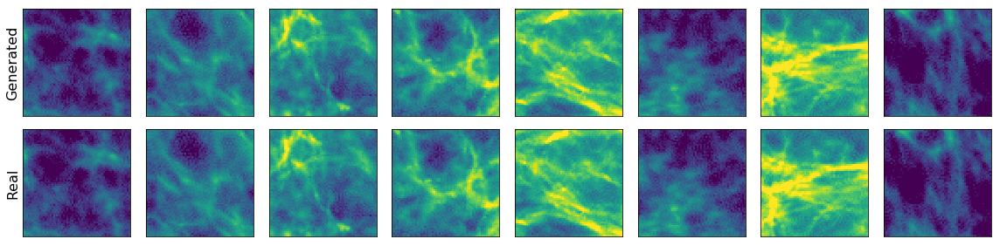

In [20]:
dataloader = torch.utils.data.DataLoader(dataset, batch_size = 8, shuffle=True, num_workers=0, drop_last = True)
data_iter = iter(dataloader)
real = data_iter.next().numpy()
visualize2d(real, real, log=False, save='', t='', show_plot=True, min_ = 0.02 , max_ = 0.25)

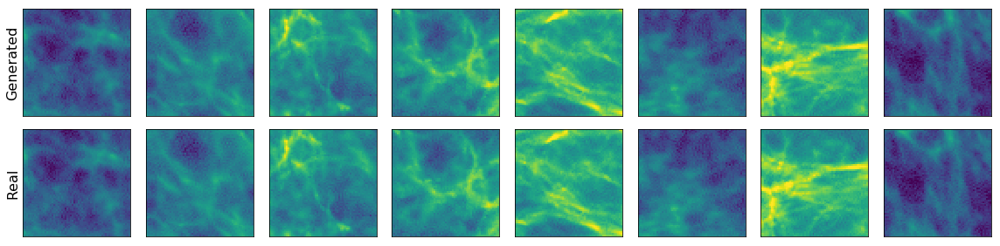

In [25]:
visualize2d(real, real, log=False, save='', t='', show_plot=True, min_ = -0.03 , max_ = 0.29)

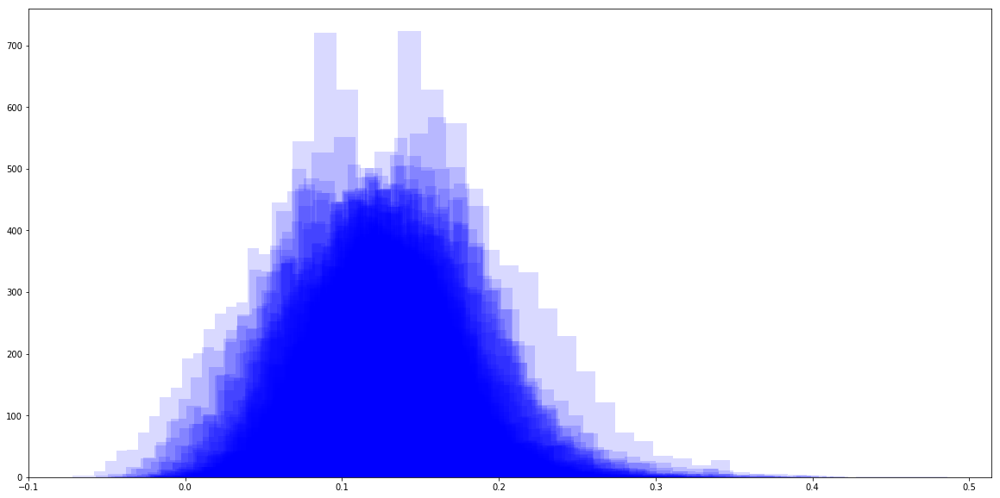

In [5]:
n=100
dataloader = torch.utils.data.DataLoader(dataset, batch_size = n, shuffle=True, num_workers=0, drop_last = True)
data_iter = iter(dataloader)
real = data_iter.next().numpy()
plt.figure(figsize=(20,10))

for i in range(n):
    a= real[i][0].mean(axis=2).flatten()
    plt.hist(a, bins=30, label='1', alpha=0.15, color='b');

In [13]:
#Save files


f = h5py.File(datapath+'fields_z=5.0.hdf5', 'r')
f = f['delta_HI']

s_sample = 64
tc={'x': [0, 0], 'y': [0,0], 'z': [0, 0]}

for n in range(100):
    arr = get_samples(f, s_sample, 1, tc)
    arr = arr[0]
    
    #print(arr.shape)
    torch.save(obj = arr, f = "real_samples/sample_" + str(n) + ".pickle")

In [52]:
class HydrogenDataset(Dataset):
    """Hydrogen Dataset"""

    def __init__(self, part, datapath, s_sample,  transform, d2):
        """
        Args:
            h5_file (string): name of the h5 file with 32 sampled cubes.
            root_dir (string): Directory with the .h5 file.
        """
        self.part = part
        self.s_sample = s_sample
        #self.t_coords = {'x': [0, 1023], 'y': [0, 1023], 'z': [0, 1023]} # Hardcoded, can use define_test()
        self.transform=transform
        self.datapath=datapath
        self.d2=d2

    def __len__(self):
        # Function called when len(self) is executed
        return len(self.part['train'])

    def __getitem__(self, index):
        print(index)
        idx = self.part['train'][index]
        
        sample = torch.load(self.datapath + "/sample_" + str(idx) + ".pickle")
        sample = np.array(sample)
        
        if self.transform!=None:
            sample = data_transform(sample, self.transform, inverse=False)
                  
                
        if self.d2 == False:
            sample = sample.reshape((1, self.s_sample, self.s_sample, self.s_sample))
        else:
            sample = sample.mean(axis=2)  
            sample = sample.reshape((1, self.s_sample, self.s_sample))

        return torch.tensor(sample)

In [62]:
dataset = HydrogenDataset(part = partition,
                            datapath='real_samples/',
                                s_sample = s_sample, 
                                nsamples = 99, 
                                transform='log_max',
                                d2=False)
    

dataloader = torch.utils.data.DataLoader(dataset, 
                                         batch_size = 32,
                                         shuffle=True, 
                                         num_workers=int(workers),
                                        drop_last = True)


In [ ]:
#Prev

class HydrogenDataset(Dataset):
    """Hydrogen Dataset"""

    def __init__(self, redshift, datapath, s_test, s_sample, nsamples, transform, rotate, d2):
        """
        Args:
            h5_file (string): name of the h5 file with 32 sampled cubes.
            root_dir (string): Directory with the .h5 file.
        """
        #file_size = os.path.getsize(root_dir + h5_file) / 1e6 # in MBs
        #print("The whole file size is " + str(int(file_size)) + " MBs")
        # self.subcubes = h5py.File('../data/sample_32.h5', 'r')
        self.s_test = s_test
        self.s_sample = s_sample
        self.t_coords = {'x': [0, 1023], 'y': [0, 1023], 'z': [0, 1023]} # Hardcoded, can use define_test()
        self.nsamples = nsamples
        self.redshift = redshift
        self.transform=transform
        self.rotate=rotate
        #self.file=h5_file
        self.datapath=datapath
        self.d2=d2

    def __len__(self):
        # Function called when len(self) is executed
        return self.nsamples

    def __getitem__(self, idx):
        """
        Here we have implemented it so that it can be used with data
        generated by get_sample() function.
        
        The output of this function is one subcube with the dimensions
        specified by get_sample() implementation.
        """
        #random_sample = np.random.randint(low = 0, high = 20000)
        
        #sample = torch.load(self.datapath + "/sample_" + str(random_sample) + ".pickle")
        #sample = np.array(sample)
        
        f = h5py.File(self.datapath+'fields_z='+self.redshift+'.hdf5', 'r')
        f = f['delta_HI'] 
        
        sample = get_samples(file = f,
                            s_sample = self.s_sample,
                             nsamples = 1,
                             test_coords = self.t_coords)
        
        if self.rotate == True:
            t=random.randint(1,4)
            if t==4:
                sample=sample
            else:
                axis=random.choice([(0,1), (0,2), (1,0), (1,2), (2,0), (2,1) ])
                sample=np.rot90(sample, t, axis)
        
        if self.d2 == True:
           # print('B',sample.shape) 
            sample = sample.mean(axis=1)
            #print(sample.shape)
        
        if self.transform!=None:
            sample = data_transform(sample, self.transform, inverse=False)
        
                
        if self.d2 == False:
            sample = sample.reshape((1, self.s_sample, self.s_sample, self.s_sample))
        else:
            sample = sample.reshape((1, self.s_sample, self.s_sample))

        return torch.tensor(sample)
